# Team Members

Adam Canton  
Tai Chowdhury  
Matt Sherga  
Neil Benson

Google Colab Link: https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt?usp=sharing

# Business Understanding

### Describe the purpose of the data you selected



*   Why was this collected?
    
    > The data is collected to analyze the demand fo the the two types of hotel bookings - resort hotels and city hotels. Both of these hotels have different characteriscs; hence they attract different types of customers. The data set will enable researchers or analysts to identify customer demographics and other features, and correlate that with the types of hotel they prefer. The infomation is vital for the business to understand different drivers for the demand by market segments and different business operation strategies.
*   Where from?

    > The dataset is from a hotel's Property Management System (PMS) SQL database. The dataset did not provide us with any of the customer's private records (i.e name, address). 
*   How big?

    > The raw dataset contains 40,060 observations from resort hotels and city hotels. There are 31 attributes that describe booking details such as customer information, hotel reservation status and dates, cancellation status and dates, and different booking tyes.
*   What's it for?

    > The empirical research will be based on real dataset from hotel's PMS database system. The real business dataset is rare to find. This three-year dataset is enabling us to find actual scenerios of diferent types customer preferences. Overall, the dataset will enables researchers or academicians to analyze hotel revenue managements or engage into any specific datamining projects.

#### Describe how you would define and measure the outcomes from the dataset.


*   Why is this data important? How do we know if mined useful knowledge from the data set?

   > The dataset reflects customers' actual preference of hotels and their overall behaviors during the length of stay. For any businesses, it is crucial for the executives, their analysts, and any third-party researchers to understand what drives the demand of their business. To improve the demand, the executives need to know all the drivers that contribute to the revenue factors. Using such data set researchers or analysts can breakdown the features of datasets and provide detail information on factors that impact customers' choice.
    >
    > Due to scarcity of real-life business datasets, this particular dataset can be very useful for any type of research. Since this dataset derives from an actual database of a company, the credibility already has been established. All the numbers in the dataset represents what actually happpened during the three year period. Analysts or researchers will be able to predict cusotmer behaviors (or predict any other attributes) more accurately from the dataset. 

    > *https://www.sciencedirect.com/science/article/pii/S2352340918315191#s0005*
    
*   How would you measure the effectiveness of a prediction algorithm?
  > We are going to predict cancelations (`is_canceled`), either a reservation canceled or did not cancel. This is a binary response, and is categorical, so this is a classification problem. We will measure the effectiveness of this prediction model by using 10-fold cross validation against the appropriate metrics of accuracy, precision, recall, and F1 score. The count of cancelations versus non-cancelations is unbalanced (~30/70) so we will need to down sample or employ other methods to get optimal results.  

    > We are going to predict length of stay (`length_of_stay`), the number of nights guests stayed at the hotel. This is a continuous response so this is a regression problem. We will measure the effectiveness of this prediction model by using 10-fold cross validation against the appropriate metrics of RMSE, or mean absolute error.





# New Features


In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

In [5]:
url="https://raw.githubusercontent.com/bensonnd/msds/master/ds7331/data/hotel_bookings.csv"
hotel = pd.read_csv(url)

*   `arrival_date` 
*   `length_of_stay`  
&emsp;&emsp;`stays_in_weekend_nights` + `stays_in_week_nights`  
*   `departure_date`  
&emsp;&emsp;`arrival_date` + `length_of_stay`
*   `total_revenue`  
&emsp;&emsp;`length_of_stay` * `ard`
*   `country_cancelation_rate`  
&emsp;&emsp;`group by country sum(cancelations)` / `group by country count()` 


In [6]:
#converting arrival y/m/d columns to a singular arrival date column
hotel['arrival_date'] = pd.to_datetime([f'{y}-{m}-{d}' for y, m, d in zip(hotel.arrival_date_year, hotel.arrival_date_month, hotel.arrival_date_day_of_month)])

# source:
# https://stackoverflow.com/questions/54487059/pandas-how-to-create-a-single-date-column-from-columns-containing-year-month

# add `departure_date` and `length_of_stay`
hotel['length_of_stay'] = hotel["stays_in_weekend_nights"] + hotel["stays_in_week_nights"]

# set `length_of_stay` as a pandas time delta
length = hotel['length_of_stay'].apply(np.ceil).apply(lambda x: pd.Timedelta(x, unit='D'))

hotel['departure_date'] = hotel['arrival_date'] + length

# source:
# https://stackoverflow.com/questions/42768649/add-days-to-date-in-pandas


# Adding total_revenue column to the data frame
hotel["total_revenue"] = abs(hotel["adr"]) * hotel["length_of_stay"]

# Adding the cancelation rate by country
hotel['is_canceled_int'] = pd.to_numeric(hotel['is_canceled'])

contry_cancellation_rate_df = pd.DataFrame(hotel.groupby(['country'])['is_canceled_int'].count())

contry_cancellation_rate_df.columns = ['country_count']
contry_cancellation_rate_df['cancelations'] = pd.DataFrame(hotel.groupby(['country'])['is_canceled_int'].sum())

contry_cancellation_rate_df['country_cancelation_rate'] = contry_cancellation_rate_df['cancelations'] / contry_cancellation_rate_df['country_count']

hotel = hotel.join(contry_cancellation_rate_df, on='country')

total_cancelations = hotel.is_canceled_int.sum()

hotel = hotel.drop(['country_count','cancelations','is_canceled_int'], axis=1)


- Added those who stayed weeknights (weeknights 1, weekends 0)  
  those who stayed weekends  (weeknights 0, weekends 1)  
  those who stayed both   (weeknights 1, weekends 1)  
  those who stayed neither (daytime bookings)  (weeknights 0, weekends 0)

In [7]:
hotel['stays_in_week_nights_cat'] = np.where(hotel['stays_in_week_nights']>0, 1, 0)
hotel['stays_in_weekend_nights_cat'] = np.where(hotel['stays_in_weekend_nights']>0, 1, 0)

Broken out date columns `arrival_date_year`, `arrival_date_month`, and `arrival_date_day_of_month` are redundant to `arrival_date`. Deleting broken out date columns.

In [8]:
hotel = hotel.drop(['arrival_date_year','arrival_date_month','arrival_date_day_of_month'], axis=1)

# Data Quality

In [9]:
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 36 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   hotel                           119390 non-null  object        
 1   is_canceled                     119390 non-null  int64         
 2   lead_time                       119390 non-null  int64         
 3   arrival_date_week_number        119390 non-null  int64         
 4   stays_in_weekend_nights         119390 non-null  int64         
 5   stays_in_week_nights            119390 non-null  int64         
 6   adults                          119390 non-null  int64         
 7   children                        119386 non-null  float64       
 8   babies                          119390 non-null  int64         
 9   meal                            119390 non-null  object        
 10  country                         118902 non-null  object 

### Checking for duplicates

In [10]:
#check for duplicate rows
dups = hotel.duplicated().sum()

# source:
# https://stackoverflow.com/questions/35584085/how-to-count-duplicate-rows-in-pandas-dataframe

In [11]:
f"{round(dups/len(hotel)*100,2)}% of all records are considered duplicates"

'26.8% of all records are considered duplicates'

This is a lot. However, the data has been scrubbed any sort of granularity related to the customer attached to each booking, such as an ID or even loyaltly tier. We will assume that duplicates are simply representations of multiple bookings by different customers on the same day, and proceed without removing the duplicates.

In [12]:
#check for duplicate columns
hotel.columns.duplicated()

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False])

In [13]:
#list columns for sanity check
hotel.columns

Index(['hotel', 'is_canceled', 'lead_time', 'arrival_date_week_number',
       'stays_in_weekend_nights', 'stays_in_week_nights', 'adults', 'children',
       'babies', 'meal', 'country', 'market_segment', 'distribution_channel',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type', 'agent',
       'company', 'days_in_waiting_list', 'customer_type', 'adr',
       'required_car_parking_spaces', 'total_of_special_requests',
       'reservation_status', 'reservation_status_date', 'arrival_date',
       'length_of_stay', 'departure_date', 'total_revenue',
       'country_cancelation_rate', 'stays_in_week_nights_cat',
       'stays_in_weekend_nights_cat'],
      dtype='object')

### Checking for columns with missing values

In [14]:
hotel.columns[hotel.isnull().any()].tolist()

['children', 'country', 'agent', 'company', 'country_cancelation_rate']

### Handling  missing values

In [15]:
# Replacing missing values for categorical to "Unknown"
cat_cols = ["country","agent","company"]
hotel[cat_cols] = hotel[cat_cols].replace({np.nan:"Unknown"})

# Replacing missing values for continuous to 0
con_cols = ["children", "country_cancelation_rate"]
hotel[con_cols] = hotel[con_cols].replace({np.nan:0})

# Source:
# https://stackoverflow.com/questions/45416684/python-pandas-replace-multiple-columns-zero-to-nan

# converting these columns to string type
hotel[cat_cols] = hotel[cat_cols].astype(str)

In [16]:
# Sanity check to verify there are no columns with missing values
hotel.columns[hotel.isnull().any()].tolist()

[]

### Summary Stats
Looking for anything that might not make sense or anything that looks odd

In [17]:
#summary stats
hotel.describe()

,is_canceled,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,is_repeated_guest,previous_cancellations,...,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,length_of_stay,total_revenue,country_cancelation_rate,stays_in_week_nights_cat,stays_in_weekend_nights_cat
count,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,...,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000,119390.000000
mean,0.370416,104.011416,27.165173,0.927599,2.500302,1.856403,0.103886,0.007949,0.031912,0.087118,...,0.221124,2.321149,101.831122,0.062518,0.571363,3.427900,357.849277,0.369855,0.935966,0.564469
std,0.482918,106.863097,13.605138,0.998613,1.908286,0.579261,0.398555,0.097436,0.175767,0.844336,...,0.652306,17.594721,50.535790,0.245291,0.792798,2.557439,335.908971,0.175336,0.244814,0.495828
min,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,-6.380000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,18.000000,16.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,69.290000,0.000000,0.000000,2.000000,146.000000,0.202243,1.000000,0.000000
50%,0.000000,69.000000,28.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,94.575000,0.000000,0.000000,3.000000,267.000000,0.273438,1.000000,1.000000
75%,1.000000,160.000000,38.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,126.000000,0.000000,1.000000,4.000000,446.250000,0.566351,1.000000,1.000000
max,1.000000,737.000000,53.000000,19.000000,50.000000,55.000000,10.000000,10.000000,1.000000,26.000000,...,21.000000,391.000000,5400.000000,8.000000,5.000000,69.000000,7590.000000,1.000000,1.000000,1.000000


`adr` has a minimum value of -6.38. This doesn't make sense because the hotel would have had to take a loss on their rooms for this one day with negative adr. Based on this, and the range of values within the variable, we deemed it appropriate to consider this a typo and turn this into a positive value. Should review max adults of 55!? Looking at outliers without norming. 

`reservation_status` and `is_canceled` are partially redundant columns and present very similar information. `is_canceled` is the binary representation of the categorical `reservation_status` where `reservation_status = Canceled` is 1 in `is_canceled`.

In [18]:
#make all adr values positive. (only one is actually negative.)
hotel['adr'] = hotel['adr'].abs()

In [19]:
hotel.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 36 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   hotel                           119390 non-null  object        
 1   is_canceled                     119390 non-null  int64         
 2   lead_time                       119390 non-null  int64         
 3   arrival_date_week_number        119390 non-null  int64         
 4   stays_in_weekend_nights         119390 non-null  int64         
 5   stays_in_week_nights            119390 non-null  int64         
 6   adults                          119390 non-null  int64         
 7   children                        119390 non-null  float64       
 8   babies                          119390 non-null  int64         
 9   meal                            119390 non-null  object        
 10  country                         119390 non-null  object 

Some adjustmentst will need to be made to some column types such as `reservation_status_date` to datetime type

### Breaking the dataset down into continous and categorical variables

In [20]:
# list of continuous attributes
hotel_continuous = ['lead_time', 'arrival_date_week_number', 'stays_in_weekend_nights', 'stays_in_week_nights', 'length_of_stay', 
                      'previous_cancellations', 'previous_bookings_not_canceled', 'booking_changes','days_in_waiting_list', 'adr', 
                      'required_car_parking_spaces', 'total_of_special_requests', 'adults', 'children', 'babies','total_revenue', 'country_cancelation_rate']

# hotel df of continuos variables in the data set
hotelCont = hotel[hotel_continuous]

# list of categorical attributes
hotel_categoricals =  ['hotel','is_canceled','deposit_type','agent','company','customer_type',
                       'reservation_status','meal', 'country', 'market_segment', 'distribution_channel', 'is_repeated_guest',
                       'reserved_room_type', 'assigned_room_type', 'stays_in_week_nights_cat','stays_in_weekend_nights_cat']

# setting categoricals as that type.
for cat in hotel_categoricals:
  hotel[cat] = hotel[cat].astype('category')

# hotel df of categorical variables
hotelCats = hotel[hotel_categoricals]


# converting reservation_status_date to datetime
hotel['reservation_status_date'] = pd.to_datetime(hotel['reservation_status_date'])


# hotel df of datetime variables
hotelDates = hotel.select_dtypes(include=['datetime64'])

### Non-Normed Continous Data - Outliers
It can be seen from the graphs below that without norming the continous data, we will deal with scale issues consistently. There are also extreme outliers. Most of the data is crammed right on top of each other. This is a scatterplot of Average Daily Rate by Length of Stay on the raw data.


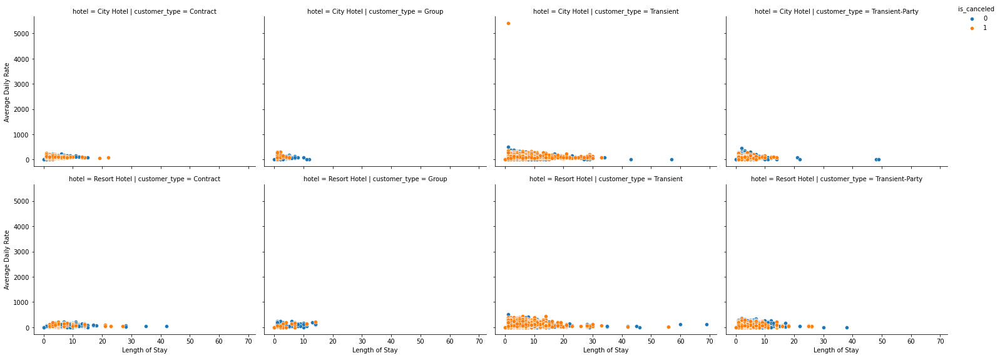

In [21]:
g = sns.FacetGrid(hotel, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

There appears to be outliers in length of stay, especially for `customer_type` Transient and Transient-Party. We also note one extreme value Average Daily Rate (~$5400) for `customer_type` Transient. With extreme values in both ADR and length of stay, we are unable to tease out any visual information about the relationships in the data. We will look to various techniques to normalize the data so that we can handle outliers.

### Summary Stats For Continous Variables

We need to norm these somehow, either min/max or Z-norming. The level of outliers may cause issues with scale even with min/max-norming, I would lean toward the Z-norming (done below). lead_time, days_in_waiting_list, adr would dominate the other continous variables due to their scale - days and monetary value respectively.

According to https://www.codecademy.com/articles/normalization min/max norming guarantees variables on the same scale but handles outliers poorly. While mean norming (z score) cant guarantee the same scale (still much closer than the original) but handles outliers better.



### Mean Normalization

In [22]:
# Mean Normalization of the Continous Variables -  still contains large outliers pictured in graphs below
hotelCont_mean_normed = (hotelCont-hotelCont.mean())/(hotelCont.std())

# and adding is_canceled back in for analysis puposes
hotelCont_mean_normed.insert(0, 'is_canceled', hotel['is_canceled'])


In [23]:
# Creating an intermediate mean normed set to display outliers or scale issues, includes categorical and date attributes
Mean_Normed_Temp = pd.concat([hotelCont_mean_normed, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
Mean_Normed_Temp.shape

(119390, 37)

In [24]:
# Removing duplicate columns
Mean_Normed_Temp = Mean_Normed_Temp.loc[:,~Mean_Normed_Temp.columns.duplicated()]

# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
Mean_Normed_Temp.shape

(119390, 36)

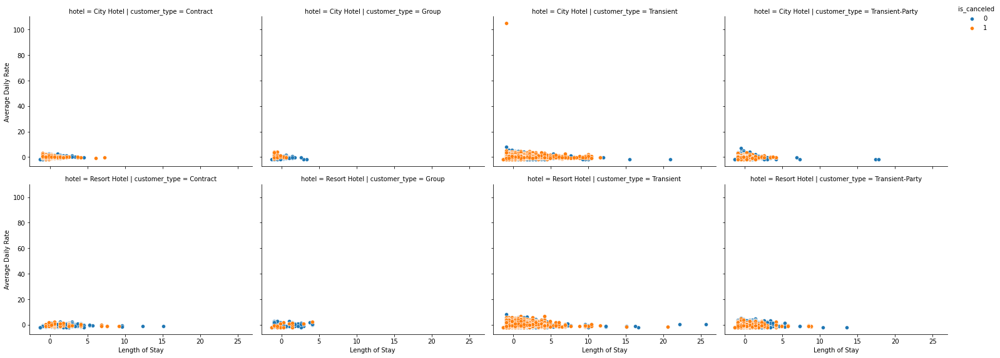

In [25]:
# Displays the same facets but now with mean normed continous variables (outliers still present and an issue)
g = sns.FacetGrid(Mean_Normed_Temp, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

After Mean Normalization of the continous variables, outliers and extreme values are still present. Moving on to the next normalization technique.

### Min Max Normalization

In [26]:
# Min/maxed normalized - looking at this describe is nicer than the others - smashes all the data between 0 and 1
hotelCont_minmax_normed = (hotelCont-hotelCont.min())/(hotelCont.max()-hotelCont.min())

# and adding is_canceled back in for analysis puposes
hotelCont_minmax_normed.insert(0, 'is_canceled', hotel['is_canceled'])

In [27]:
# Creating an intermediate Min Max normed set to display outliers or scale issues, includes categorical and date attributes
MinMax_Normed_Temp = pd.concat([hotelCont_minmax_normed, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
MinMax_Normed_Temp.shape

(119390, 37)

In [28]:
# Removing duplicate columns
MinMax_Normed_Temp = MinMax_Normed_Temp.loc[:,~MinMax_Normed_Temp.columns.duplicated()]
 
# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
MinMax_Normed_Temp.shape

(119390, 36)

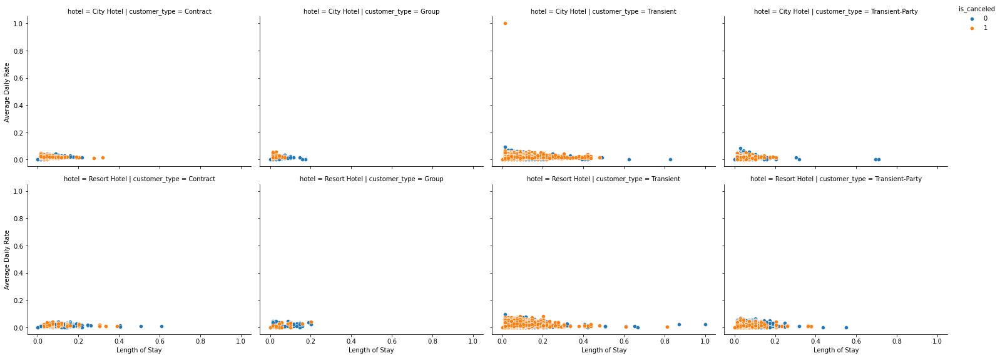

In [29]:
# Displays the same facets but now with min/max normed continous variables (outliers still present and an issue)
g = sns.FacetGrid(MinMax_Normed_Temp, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

The min max norming forces an equal scale on all of our variables, but due to the extreme outliers present, the data is still crunched and not very useful visually. It seems we will have to cut out some outliers to visualize these columns appropriately. It is hardly useful to draw any conclusions about relationships in the data from this perspective with min/max norming.

### Z Normalization
Created the `hotel_nol` df or hotel with no outliers. Outliers that were greater than 5 standard devs out were removed from the data frame.

5 std.devs was chosen due the size of our data set. A 1/100,000 chance corresponds to an approximate 4.26 Z-score, so we rounded up to the nearest integer from there.



In [30]:
hotel_nol = hotelCont_mean_normed[(np.abs(hotelCont_mean_normed) < 5).all(axis=1)]

# Data Description - z-normalized without the outliers
hotel_nol.describe()

,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,length_of_stay,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,adults,children,babies,total_revenue,country_cancelation_rate
count,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,1.152320e+05,115232.000000,115232.000000
mean,-0.009892,-0.000554,-0.023360,-0.035361,-0.035507,-0.040462,-0.053044,-0.049604,-0.073151,-0.006872,-0.008245,-0.010741,-0.002937,-0.010648,-8.157892e-02,-0.035396,-0.009569
std,0.994596,0.999700,0.937205,0.884034,0.874183,0.272161,0.295707,0.783124,0.419556,0.928508,0.971920,0.984140,0.841819,0.970610,5.225010e-14,0.879937,0.998472
min,-0.973315,-1.923183,-0.928887,-1.310234,-1.340365,-0.103179,-0.091554,-0.338988,-0.131923,-2.015040,-0.254872,-0.720691,-3.204779,-0.260658,-8.157892e-02,-1.065316,-2.109410
25%,-0.804875,-0.820659,-0.928887,-0.786204,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,-0.629878,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.630675,-0.955951
50%,-0.336986,-0.012140,0.072502,-0.262173,-0.167316,-0.103179,-0.091554,-0.338988,-0.131923,-0.135177,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.277603,-0.580914
75%,0.505213,0.796378,1.073890,0.261857,0.223700,-0.103179,-0.091554,-0.338988,-0.131923,0.474295,-0.254872,0.540664,0.247896,-0.260658,-8.157892e-02,0.244600,1.120684
max,4.912721,1.898902,4.078056,4.978132,4.915895,4.634269,4.583100,4.260083,4.926412,4.983396,3.821916,4.324728,3.700571,4.757468,-8.157892e-02,4.998708,3.593931


In [31]:
hotel_nol.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115232 entries, 0 to 119389
Data columns (total 18 columns):
 #   Column                          Non-Null Count   Dtype   
---  ------                          --------------   -----   
 0   is_canceled                     115232 non-null  category
 1   lead_time                       115232 non-null  float64 
 2   arrival_date_week_number        115232 non-null  float64 
 3   stays_in_weekend_nights         115232 non-null  float64 
 4   stays_in_week_nights            115232 non-null  float64 
 5   length_of_stay                  115232 non-null  float64 
 6   previous_cancellations          115232 non-null  float64 
 7   previous_bookings_not_canceled  115232 non-null  float64 
 8   booking_changes                 115232 non-null  float64 
 9   days_in_waiting_list            115232 non-null  float64 
 10  adr                             115232 non-null  float64 
 11  required_car_parking_spaces     115232 non-null  float64 
 12  to

In [32]:
# Creating the normed full data set w/out outliers above 5 std.devs, includes categorical and date attributes
normed_full_nol = pd.concat([hotel_nol, hotelCats, hotelDates], axis = 1, join = 'inner')

# Quality check on merged data
normed_full_nol.shape

(115232, 37)

In [33]:
# Removing duplicate columns
normed_full_nol = normed_full_nol.loc[:,~normed_full_nol.columns.duplicated()]

# Source:
# https://stackoverflow.com/questions/32041245/fast-method-for-removing-duplicate-columns-in-pandas-dataframe

# Quality check on merged data - duplicate columns removed
normed_full_nol.shape

(115232, 36)

In [34]:
obs_lost = (len(hotel) - len(normed_full_nol))
percent_lost = round(obs_lost/len(hotel)*100,2)

print(f"Removing outliers beyond 5 standard deviations resulted in a loss of {obs_lost} observations or ~{percent_lost}% of total obs.\n",
"We think this is an accetable loss in order to be able to really visualize our data. Some of these extreme outliers are not indicative \n",
"of normal trends, or we do not have enough observations as extreme to be able to model them effectively.")

Removing outliers beyond 5 standard deviations resulted in a loss of 4158 observations or ~3.48% of total obs.
 We think this is an accetable loss in order to be able to really visualize our data. Some of these extreme outliers are not indicative 
 of normal trends, or we do not have enough observations as extreme to be able to model them effectively.


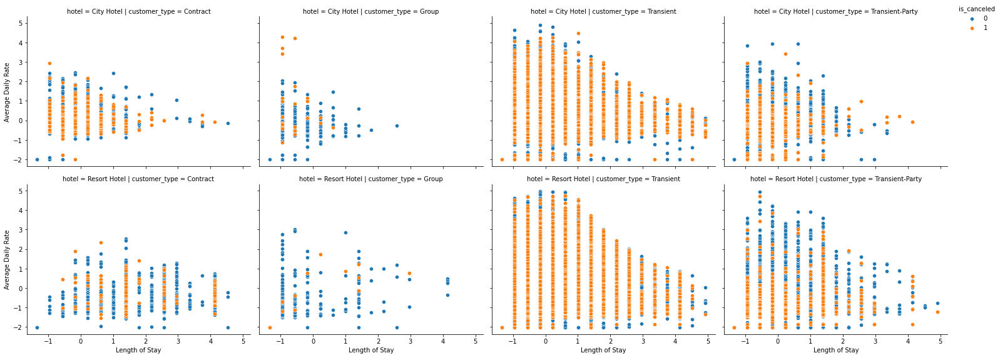

In [35]:
# Displays the same facets but now without the extreme outliers
g = sns.FacetGrid(normed_full_nol, col='customer_type', row = 'hotel', hue="is_canceled", height=4, aspect=4/3)
g.map(sns.scatterplot, "length_of_stay", "adr")
g.set_axis_labels("Length of Stay", "Average Daily Rate")
g.add_legend(loc = 1)

We can finally start to see some of the patterns within the data once we have z-normed the data and filtered out any outliers that are beyond 5 standard deviations. 

From this we can see that Transient customer type makes up the block of reservations, and consequently also has the highest number of cancelations.

Group reservations by far had the lowest number of cancelations. 

It looks as though, for Resort Hotels for Transient-Party customer group, as both the length of stay and ADR increase, cancelations tend to decrease.

In almost all groups, across both htoel types, as length of stay increases, ADR decreases, and we see a negative relationship between ADR and length of stay. This could be attributed to a few things - discounted rates for longer stays, or increased lead time for longer stays could mean lower rates. We should investigate the relationship between lead time and length of stay and lead time and ADR.

Between the two hotel types, the shape of the data is very similar between customer types except for a slight difference in Contract and Group type customers.

# Data Meaning and Type

### Descriptions

#### hotel (categorical): 
<ul>This data was collected from two hotels, each 
of a different type </ul>
 
- **Resort Hotel**  
- **City Hotel**  


---


#### is_canceled (categorical):
<ul>This column identifies whether the booking ended up being canceled</ul>


- **1** - yes  
- **2** - no


---


#### lead_time (continuous):
<ul><b>days elapsed</b> between entering date of booking and arrival date</ul>


---


#### arrival_date_week_number (continuous):
<ul><b>week number</b> of year for arrival date</ul>


---

#### stays_in_weekend_nights (continuous):
<ul><b>Number of weekend nights</b> (Saturday or Sunday) the guest stayed or booked to stay at the hotel

Our group determined that when weekend and week nights are both 0 for a guest (and they didn't cancel), that means they were only sold on a day rate. They didn't stay overnight. You might see this with rooms used for meetings, or trunk shows for example.</ul>

---


#### stays_in_week_nights (continuous):
<ul><b>Number of week nights</b> (Monday to Friday) the guest stayed or booked to stay at the hotel

Our group determined that when weekend and week nights are both 0 for a guest (and they didn't cancel), that means they were only sold on a day rate. They didn't stay overnight. You might see this with rooms used for meetings, or trunk shows for example.</ul>

---


#### adults (continuous):	
<ul><b>number of adults</b>

The hotels in this dataset didn't seem to have a requirement for at least one adult. We don't have enough information to know, so 0 is considered valid here.</ul>


---


#### children (continuous):
<ul><b>number of children</b></ul>
	

---


#### babies (continuous):
<ul><b>number of babies</b></ul>
	

---


#### meal (categorical):
<ul>Type of meal booked. Categories are presented in standard hospitality meal packages:</ul> 

- **Undefined/SC** – no meal package  
- **BB** – Bed & Breakfast  
- **HB** – Half board (breakfast and one other meal – usually dinner)  
- **FB** – Full board (breakfast, lunch and dinner)


---


#### country (categorical):
<ul><b>Country of origin</b> - Categories are represented in the ISO 3155–3:2013 format</ul>


---


#### market_segment (categorical):
<ul>Market segment designation</ul> 

- **TA** - Travel Agents  
- **TO** - Tour Operators 


---


#### distribution_channel (categorical):
<ul>Booking distribution channel</ul>  

- **TA** - Travel Agents  
- **TO** - Tour Operators


---


#### is_repeated_guest (categorical):
<ul>Value indicating if the booking name was from a repeated guest</ul>

- **1** - repeated guest  
- **0** - not repeated guest


---


#### previous_cancellations (continuous):
<ul><b>Number of previous bookings that were cancelled</b> by the customer prior to the current booking</ul>


---


#### previous_bookings_not_canceled (continuous):
<ul><b>Number of previous bookings not cancelled</b> by the customer prior to the current booking</ul>


---


#### reserved_room_type (categorical):
<ul><b>Code of room type reserved</b>. Code is presented instead of designation for anonymity reasons</ul>


---


#### assigned_room_type (categorical):
<ul><b>Code for the type of room assigned</b> to the booking. Sometimes the assigned room type differs from the reserved room type due to hotel operation reasons (e.g. overbooking) or by customer request. Code is presented instead of designation for anonymity reasons</ul>


---


#### booking_changes (continuous):
<ul><b>Number of changes/amendments</b> made to the booking from the moment the booking was entered on the PMS until the moment of check-in or cancellation</ul>


---


#### deposit_type (categorical):
<ul>Indication on if the customer made a deposit to guarantee the booking. This variable can assume three categories:</ul>

- **No Deposit** – no deposit was made  
- **Non Refund** – a deposit was made in the value of the total stay cost  
- **Refundable** – a deposit was made with a value under the total cost of stay


---


#### agent (categorical):
<ul><b>ID of the travel agency</b> that made the booking</ul>


---


#### company (categorical):
<ul><b>ID of the company/entity</b> that made the booking or responsible for paying the booking. ID is presented instead of designation for anonymity reasons</ul>


---


#### days_in_waiting_list (continuous):
<ul><b>Number of days the booking was in the waiting list</b> before it was confirmed to the customer</ul>


---


#### customer_type (categorical):
<ul>Type of booking, assuming one of four categories:</ul>

- **Contract** - when the booking has an allotment or other type of contract associated to it  
- **Group** – when the booking is associated to a group  
- **Transient** – when the booking is not part of a group or contract, and is not associated to other transient booking  
- **Transient-party** – when the booking is transient, but is associated to at least other transient booking


---


#### adr (continuous):
<ul><b>Average Daily Rate</b> is defined by dividing the sum of revenue by the total number of staying nights at the booking level.

Our group assumes this is in USD, as it is not stated anywhere in the source paper. </ul>


---


#### required_car_parking_spaces (continuous):
<ul><b>Number of car parking spaces</b> required by the customer</ul>


---


#### total_of_special_requests (continuous):
<ul><b>Number of special requests</b> made by the customer (e.g. twin bed or high floor)</ul>


---


#### reservation_status (categorical):
<ul>Reservation last status, assuming one of three categories: </ul>

- **Canceled** – booking was canceled by the customer  
- **Check-Out** – customer has checked in but already departed  
- **No-Show** – customer did not check-in and did inform the hotel of the reason why


---


#### reservation_status_date (datetime):
<ul><b>Date at which the last status was set</b>. This variable can be used in conjunction with the Reservation_Status to understand when was the booking canceled or when did the customer check-out of the hotel</ul>


---

#### arrival_date (datetime):
<ul>Dervide column: It is the <b>date the guest checked in</b>. This was created by our group using the variables arrival_date year, arrival_date_month, and arrival_date_day_of_month</ul>


---


#### departure_date (datetime):
<ul>Dervived column: This was created by our group by adding arrival_date and length_of_stay. It is the <b>date the guest checked out</b>, if they were not a cancelation</ul>


---


#### length_of_stay (continuous):
<ul>Dervived column: This was created by our group using stays_in_weekend_nights and stays_in_week_nights. It is the <b>total number of nights</b> the guest stayed at the hotel</ul>

---

#### total_revenue (continuous):
<ul>Dervived column: The <b>total revenue derived</b> by multiplying ADR (Average Daily Rate) by Length of Stay. 

Our group assumes this is in USD.</ul>

---


#### Source
https://www.sciencedirect.com/science/article/pii/S2352340918315191

### Info

In [34]:
# After cleanup, normalization, and removal of outliers beyond 5 standard deviations
normed_full_nol.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 115232 entries, 0 to 119389
Data columns (total 36 columns):
 #   Column                          Non-Null Count   Dtype         
---  ------                          --------------   -----         
 0   is_canceled                     115232 non-null  category      
 1   lead_time                       115232 non-null  float64       
 2   arrival_date_week_number        115232 non-null  float64       
 3   stays_in_weekend_nights         115232 non-null  float64       
 4   stays_in_week_nights            115232 non-null  float64       
 5   length_of_stay                  115232 non-null  float64       
 6   previous_cancellations          115232 non-null  float64       
 7   previous_bookings_not_canceled  115232 non-null  float64       
 8   booking_changes                 115232 non-null  float64       
 9   days_in_waiting_list            115232 non-null  float64       
 10  adr                             115232 non-null  float64

# Simple Statistics

See also -  
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=c_dOoD7gOKlr&line=2&uniqifier=1">Data Quality: Summary Statistics</a> 
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=5cafOQLfZ8MF&line=2&uniqifier=1">Data Quality: Non-normed Continuous Data</a> 
- <a target="_self" href="https://colab.research.google.com/drive/1AoIKPl-hSjqTj-gzBb7u9xEGqDZxO9Kt#scrollTo=zjs5gbI2ih2f&line=3&uniqifier=1">Data Quality: Summary Stats for Continuous Variables</a> 





In [35]:
normed_full_nol.describe()

,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,length_of_stay,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,adults,children,babies,total_revenue,country_cancelation_rate
count,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,115232.000000,1.152320e+05,115232.000000,115232.000000
mean,-0.009892,-0.000554,-0.023360,-0.035361,-0.035507,-0.040462,-0.053044,-0.049604,-0.073151,-0.006872,-0.008245,-0.010741,-0.002937,-0.010648,-8.157892e-02,-0.035396,-0.009569
std,0.994596,0.999700,0.937205,0.884034,0.874183,0.272161,0.295707,0.783124,0.419556,0.928508,0.971920,0.984140,0.841819,0.970610,5.225010e-14,0.879937,0.998472
min,-0.973315,-1.923183,-0.928887,-1.310234,-1.340365,-0.103179,-0.091554,-0.338988,-0.131923,-2.015040,-0.254872,-0.720691,-3.204779,-0.260658,-8.157892e-02,-1.065316,-2.109410
25%,-0.804875,-0.820659,-0.928887,-0.786204,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,-0.629878,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.630675,-0.955951
50%,-0.336986,-0.012140,0.072502,-0.262173,-0.167316,-0.103179,-0.091554,-0.338988,-0.131923,-0.135177,-0.254872,-0.720691,0.247896,-0.260658,-8.157892e-02,-0.277603,-0.580914
75%,0.505213,0.796378,1.073890,0.261857,0.223700,-0.103179,-0.091554,-0.338988,-0.131923,0.474295,-0.254872,0.540664,0.247896,-0.260658,-8.157892e-02,0.244600,1.120684
max,4.912721,1.898902,4.078056,4.978132,4.915895,4.634269,4.583100,4.260083,4.926412,4.983396,3.821916,4.324728,3.700571,4.757468,-8.157892e-02,4.998708,3.593931


<AxesSubplot:xlabel='customer_type', ylabel='count'>

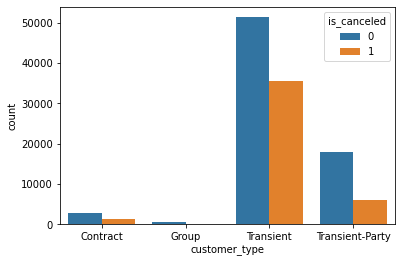

In [36]:
# The following chart shows customer type count. We notice that both of the hotel types have more 'Transient' customers than any other customer types
#customer_typeplt = 
sns.countplot(x="customer_type", hue ="is_canceled", data=normed_full_nol)


Out of four differnt types of customers, transient customers are the highest number of customers. These customers are not part of any contract or associated with any group. Most of these customers do not tend to cancel. In terms of cancelation as a whole, transient customers also tend to cancel compare to other customer types. 

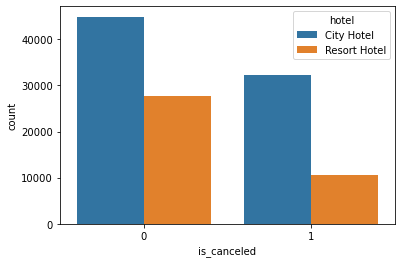

In [37]:
# The following chart shows cancellation data by hotel type

cancelation_by_hotel = sns.countplot(x="is_canceled", hue ="hotel", data=normed_full_nol)

Both city hotels and resorts have customers who do not typically cancel their plan. In terms of cancelation status as whole, city hotel customers tends canel more compare to customers who book at resort hotels. 

<AxesSubplot:title={'center':'Demand by Arrival Date'}, xlabel='arrival_date'>

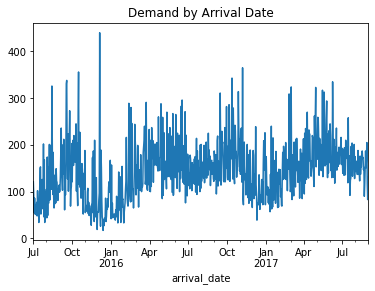

In [38]:
# Demand by arrival date 

arrivemonth_dist = normed_full_nol.groupby("arrival_date").size()
arrivemonth_dist.plot (title = "Demand by Arrival Date")



The chart by the `arrival_date` shows that there tends to be more demand around November. There tends do me a slowdownd around January-February timeframe.

<AxesSubplot:ylabel='country'>

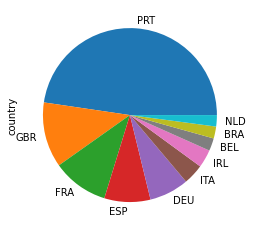

In [39]:
# Top Countries by Bookings (Top 10)
temp = normed_full_nol.country.value_counts().sort_values(ascending=False).head(10)
temp.plot(kind='pie')

There are more customers visitng from Europe which seems normal since these hotels are located in Europe. Most of these European customers are from Portugal. 

In [40]:
# Trying to unstanding which months have most (or least) cancellations
normed_full_nol_months = normed_full_nol[["arrival_date","is_canceled"]].astype({"arrival_date": 'datetime64[ns]', "is_canceled": int})
normed_full_nol_months.groupby(normed_full_nol_months["arrival_date"].dt.strftime('%b'))["is_canceled"].sum()

arrival_date
Apr    4431
Aug    5050
Dec    2274
Feb    2653
Jan    1731
Jul    4585
Jun    4469
Mar    2974
May    4478
Nov    2090
Oct    4095
Sep    3950
Name: is_canceled, dtype: int64

By looking at cancelation count by 12-month period, August tends to have the most cancelation and January tends to have least cancelation. The previous chart can support this senerio since, other than winter season, there tend be some growth in demand around summer time. So there can be some expectation for some of the customers to cancel their bookings. January tends to have least demand so tells why there tends to be less cancelations around that time.

Text(0.5, 1.0, 'Total Revenue Per Year (in millions)')

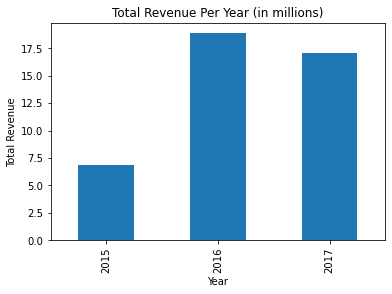

In [41]:
# Revenue Breakdown by Arrival Year and total revenue
# plotting sums per year of total revenue. setting values on a scale of millions for 
# easier viewing in plot
hg = hotel.groupby(by=pd.DatetimeIndex(hotel['arrival_date']).year)['total_revenue'].sum()

hg = hg.div(1000000).round(2)

hg.plot(kind='bar') 
plt.xlabel('Year')
plt.ylabel('Total Revenue')
plt.title("Total Revenue Per Year (in millions)")


#adapted from 
#https://discuss.analyticsvidhya.com/t/how-can-we-plot-a-bar-chart-with-categorical-values-on-x-axis-in-python/1046

#and
#https://pythonprogramming.net/legends-titles-labels-matplotlib-tutorial/


Total Revenue by Year chart shows that there is dramatic increase in revenue during 2016 by 174%. There is a slight decrease in revenue during 2017. 

<AxesSubplot:xlabel='deposit_type'>

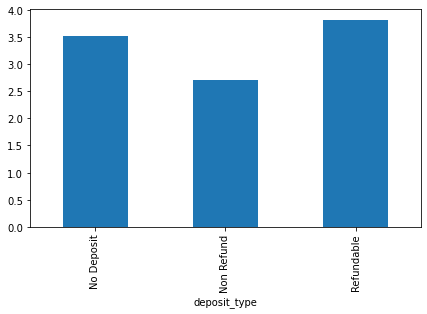

In [42]:
# Length_of_stay by deposit types
fig = plt.figure(figsize =(7, 4)) 

# Horizontal Bar Plot 
dtg = hotel.groupby(by=hotel.deposit_type)['length_of_stay'].mean()


dtg.plot(kind = 'bar') 


Customers, who choose refundable option, tend to stay the longest. Also, we notice customers, who do not commit to any depost, tend to stay longer as well compared to customers who choose non-refund option. 

# Visualize Attributes

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'Aviation'),
  Text(1, 0, 'Complementary'),
  Text(2, 0, 'Corporate'),
  Text(3, 0, 'Direct'),
  Text(4, 0, 'Groups'),
  Text(5, 0, 'Offline TA/TO'),
  Text(6, 0, 'Online TA'),
  Text(7, 0, 'Undefined')])

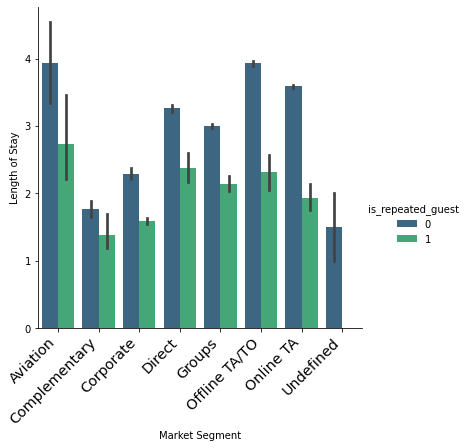

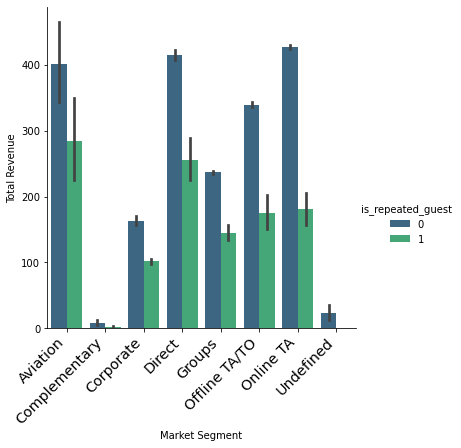

In [43]:
# Length_of_stay by Market Segment
ax= sns.catplot(x="market_segment", y="length_of_stay", hue = 'is_repeated_guest', palette = 'viridis', kind="bar", data=hotel)
ax.set_titles('Length of Stay by Market Segment')
ax.set_ylabels ('Length of Stay')
ax.set_xlabels ('Market Segment')
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-large'  
)
# Total Revenue by Market Segment
rv= sns.catplot(x="market_segment", y="total_revenue", hue = 'is_repeated_guest', palette = 'viridis', kind="bar", data=hotel)
rv.set_titles('Revenue by Market Segment')
rv.set_ylabels ('Total Revenue')
rv.set_xlabels ('Market Segment')
plt.xticks(
    rotation=45, 
    horizontalalignment='right',
    fontweight='light',
    fontsize='x-large'  
)

The following charts show most of the non-repeating customers drive the revenue growth by staying longer. Online and offline travel agents tend to book the hotel rooms the most for their clients, followed by customers from aviation industry. We also notice customers who directly book their rooms also produce more revenue and tend to stay longer period. Complementary market segment tends to produce least revenue and lower length of stay period. 

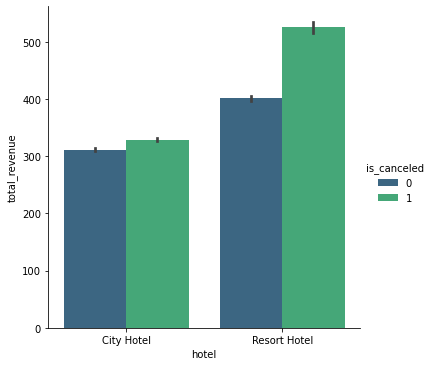

In [44]:
# Bar plot for revenue by hotel type
# plotting sums per year of total revenue. setting values on a scale of millions for 
# easier viewing in plot
sns.catplot(x="hotel", y="total_revenue", hue = 'is_canceled', palette = 'viridis', kind="bar", data=hotel)

Resort hotels generates more revenue compared to city hotels. Customers who tend to cancel more generate to most revenue for both types of hotel. - Is this realized revenue? or lost revenue for cancelations?

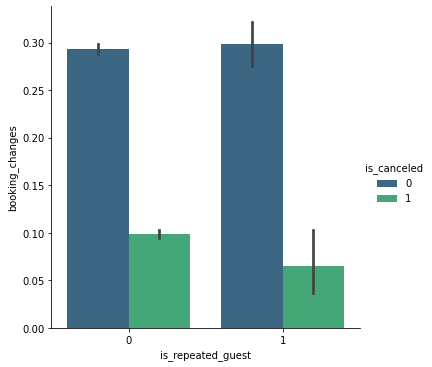

In [ ]:
# Booking changes by customer. 
sns.catplot(x="is_repeated_guest", y="booking_changes", hue = 'is_canceled', palette = 'viridis', kind="bar", data=hotel)

Overall, repeated customers tend to make slightly more changes to their bookings compared to non-repeated customers. Both of these customer types do not tend to cancel their reservations.

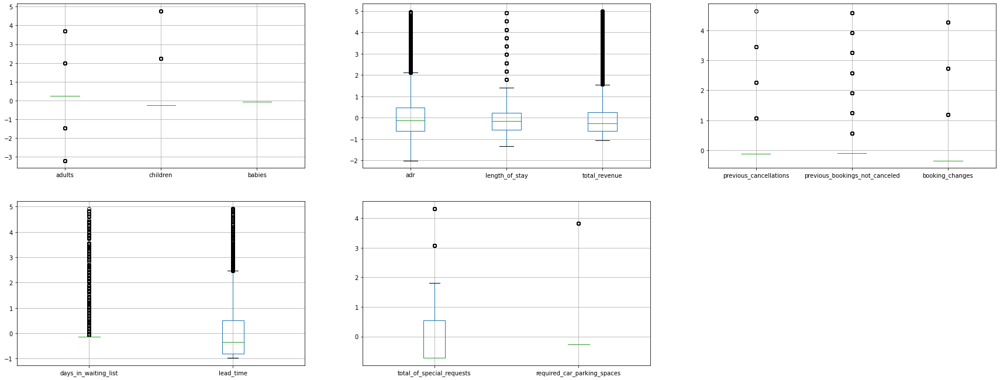

In [45]:
# lets look at the boxplots separately
# acquired from asynch notebook
# can still see that outliers are an issue in some features even though we've cut down 

vars_to_plot_separate = [
                         ['adults','children','babies'],
                         ['adr', 'length_of_stay', 'total_revenue'],
                         ['previous_cancellations','previous_bookings_not_canceled','booking_changes'],
                         ['days_in_waiting_list','lead_time'],
                         ['total_of_special_requests','required_car_parking_spaces']
                        ]

plt.figure(figsize=(30, 30))

for index, plot_vars in enumerate(vars_to_plot_separate):
    plt.subplot(len(vars_to_plot_separate), 3, index+1)
    ax = normed_full_nol.boxplot(column=plot_vars)
    


Many of our variables are very right skewed.  `Adr`, `adults`, and maybe `length_of_stay` are the only near-normal attributes.  However, our forced norming and trimming allows all our continuous variables to viewed on the same approximate scale. 

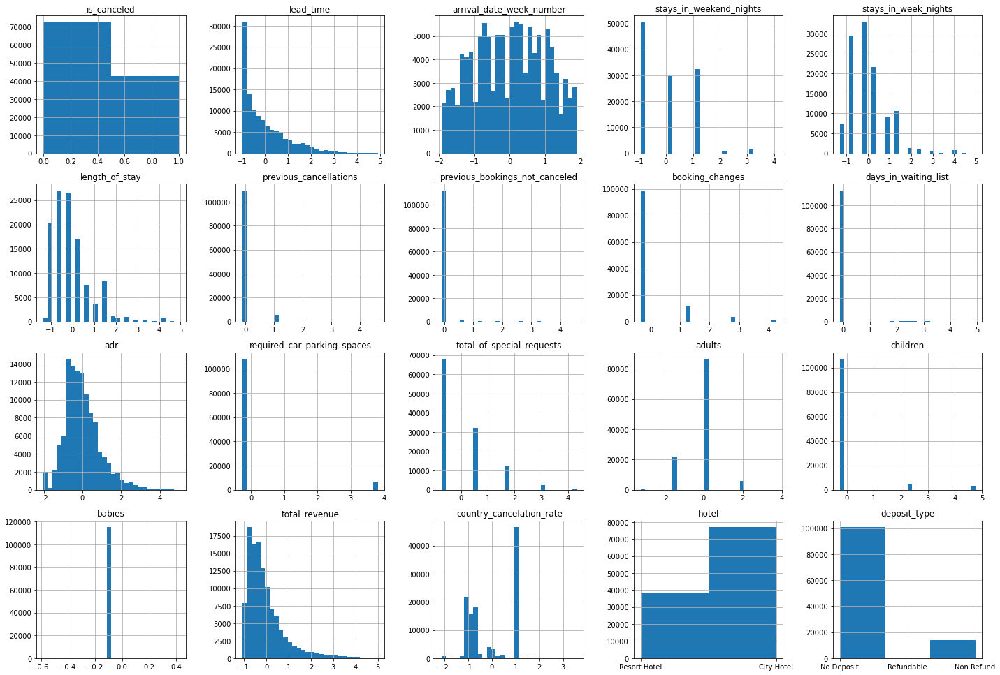

In [46]:
# some weird looking results here - might be some good candidates to turn into booleans
plt.figure(figsize=(20, 20))

# temporarily removing date columns just for this visualization
no_dates_cols = [col for col in normed_full_nol.columns if col not in hotelDates.columns]
normed_full_nol_no_dates = normed_full_nol[no_dates_cols]

for index, col in enumerate(no_dates_cols):
    # skip datetime and massive categoricals 
    if col in ["country","agent","company"] or normed_full_nol[col].dtype.name == "datetime64[ns]":
      break
    bins = 30
    if normed_full_nol[col].dtype.name == "category":
      bins = len(normed_full_nol[col].dtypes.categories)
    plt.subplot(6,5,index+1)
    normed_full_nol[col].hist(bins = bins)
    plt.title(normed_full_nol.columns[index])

plt.tight_layout()

Here we can see the distributions from the normed and trimmed data. `is_canceled` false has nearly double the observations of `is_canceled` true. Likewise, there are about double the observations for the city hotel than the resort hotel. Due to the large number of right skewed variables, when creating our models we will need to look into a log transform or possibly some other functional transformation.

# Explore Joint Attributes

### Z Normed Data With Outliers Removed
With the extreme outliers removed we can finally see some actual, meaningful relationships in our data. 


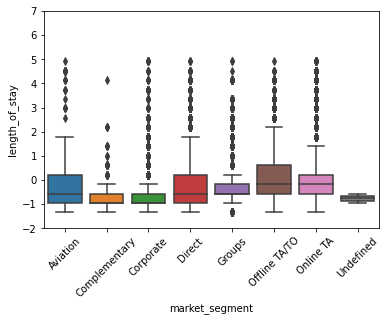

In [47]:
# length_of_stay Boxplot By Market Segment
plt.ylim(-2,7)
plt.xticks(rotation=45)

box2 = sns.boxplot(x='market_segment', y = 'length_of_stay', data = normed_full_nol )

Length of stay median values are generally clustered close together when looking at the distribution of length of stay by market segment. Other than Offline TA/TO having a higher median stay than other market segments, market segment may not be extraordinarly useful in regressing `length_of_stay` predictions. Every market segment has a rightly skew distribution. To note, this skew is still very present after normalizing the data to a z-score. Might consider exploring log transforming the repsonse variable `length_of_stay`.

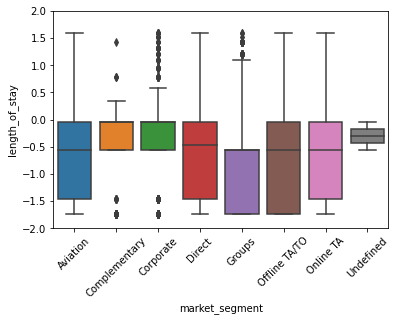

In [48]:
# length_of_stay Boxplot By Market Segment - log transformation of the target variable `length_of_stay`
plt.ylim(-2,2)
plt.xticks(rotation=45)

box2 = sns.boxplot(x='market_segment', y=np.log(abs(normed_full_nol['length_of_stay'])+.01), data = normed_full_nol )

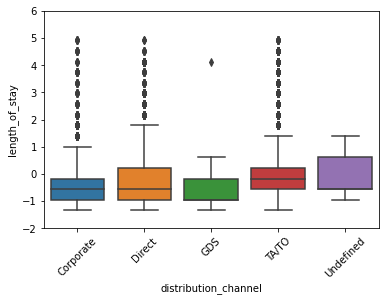

In [49]:
# length_of_stay Boxplot by Distribution Channel

plt.ylim(-2,6)
plt.xticks(rotation=45)

book_seg = sns.boxplot(x='distribution_channel', y = 'length_of_stay', data = normed_full_nol )

There appears to be a lot of overlap between market segment categorical variable and distribution channel categorical variable. Might consider labeling these two as redundant but at slightly different granularity levels.

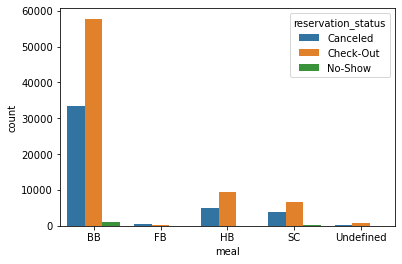

In [50]:
# ADR by meal plan
cancelation_by_hotel = sns.countplot(x="meal", hue ="reservation_status", data=hotel)

<AxesSubplot:ylabel='hotel,deposit_type'>

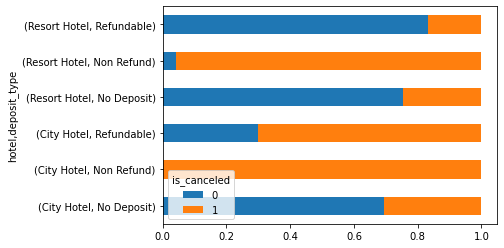

In [51]:
# Crosstab hotel and deposit type by cancelation 
Canceled_bydeposittype = pd.crosstab([normed_full_nol['hotel'], normed_full_nol['deposit_type']], normed_full_nol['is_canceled'])
Canceled_bydeposittype.div(Canceled_bydeposittype.sum(1),axis=0).plot.barh(stacked = True)

Cross Tabulated Hotel type and Deposit type, by cancelation decision
Biggest difference in the refundable class `deposit_type` between resort and city, close in non-refundable and no deposit

<AxesSubplot:ylabel='hotel,customer_type'>

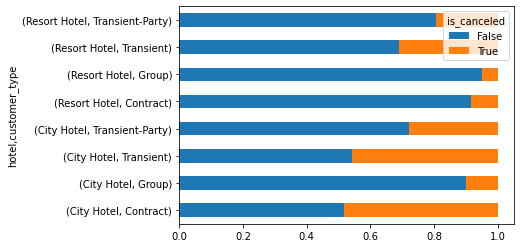

In [52]:
# crosstab hotel and customer type by cancelation
Canceled_bycustomertype = pd.crosstab([normed_full_nol['hotel'],normed_full_nol['customer_type']], 
                       normed_full_nol.is_canceled.astype(bool))
Canceled_bycustomertype.div(Canceled_bycustomertype.sum(1),axis=0).plot.barh(stacked = True)

Biggest difference between contract class of `customer_type`. City seems to have more cancelation in general.  Plans taking you to a city hotel are more likely to change than plans taking you to a resort possibly.

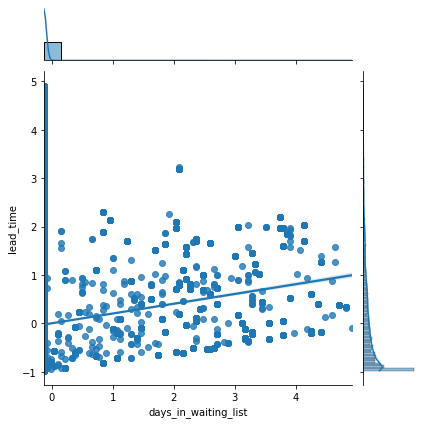

In [53]:
# Relationship between number of days in wait-list and lead time
sns.jointplot(x="days_in_waiting_list", y="lead_time", data=normed_full_nol, kind='reg')

The relationship between `lead_time` and `days_in_waiting_list` shows positive correlation between the two of 0.085. Not the strongest relationship, but a positive one nonetheless.

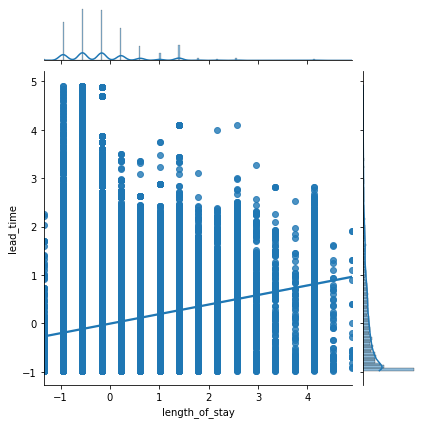

In [54]:
# Relationship between lead time and length of stay
sns.jointplot(x="length_of_stay", y="lead_time", data=normed_full_nol, kind='reg')

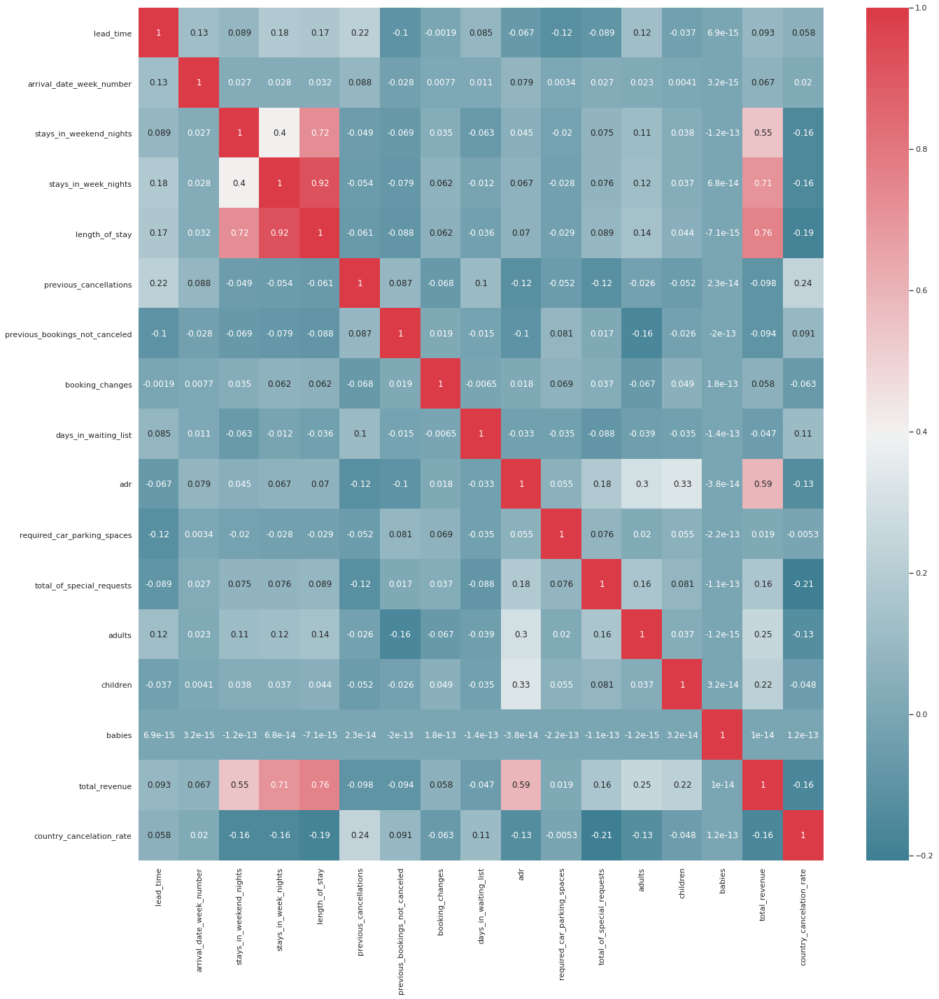

In [55]:
# plot the correlation matrix using seaborn
# nothing is highly correlated, children and adults lightly correlated with adr (doesn't adr take number of people into account?)

sns.set(style="darkgrid") # one of the many styles to plot using
cmap = sns.diverging_palette(220, 10, as_cmap=True) # one of the many color mappings
f, ax = plt.subplots(figsize=(20, 20))
sns.heatmap(normed_full_nol.corr(), cmap=cmap, annot=True)

f.tight_layout()

# Source:
# copied from asynch notebook

Correlation Matrix:

The correlations matrix plot using using the normalized data sans outliers tells us that there are not many strong relationships between the continuous features. With five additional features, we start to notice correlations with `length_of_stay` and `stays_in_week_nights` and `stays_in_weekend_nights` - this makes sense, because `length_of_stay` is derived from these two columns. Similarly, since `total_revenue` is a derivitive of `length_of_stay`, we notice similar relationship between those two attributes as well.

Because of the obvious colinearity between `stays_in_week_nights` and `stays_in_weekend_nights` and `length_of_stay` and `total_revenue`, it might make sense to explore encoding `stays_in_week_nights` and `stays_in_weekend_nights` as binaries - which would segment our bookings into four new categories:

* those who stayed weeknights
* those who stayed weekends
* those who stayed both
* those who stayed neither (daytime bookings)  

Other than that, there are surpisingly few colinear relationships in our data set among the continuous variables.

<AxesSubplot:xlabel='booking_changes', ylabel='adr'>

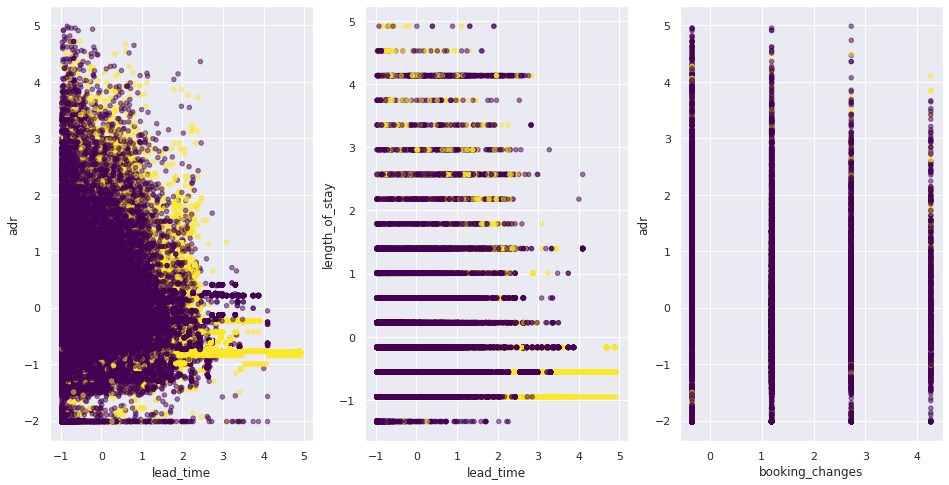

In [56]:
# showing a better view of the adr v leadtime colored by is_canceled
# some of the graphs look better as the orginal hotel, others as normed.

fig = plt.figure(3, figsize=(16,8))

ax1 = fig.add_subplot(1, 3, 1)
normed_full_nol.plot.scatter(x = "lead_time", y = "adr", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax1)

ax2 = fig.add_subplot(1, 3, 2)
normed_full_nol.plot.scatter(x = "lead_time", y = "length_of_stay", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax2)

ax3 = fig.add_subplot(1, 3, 3)
normed_full_nol.plot.scatter(x = "booking_changes", y = "adr", c = normed_full_nol['is_canceled'], colormap = 'viridis', alpha = 0.5, ax=ax3)

#adapted from https://towardsdatascience.com/master-the-art-of-subplots-in-python-45f7884f3d2e

# Explore Attributes and Class

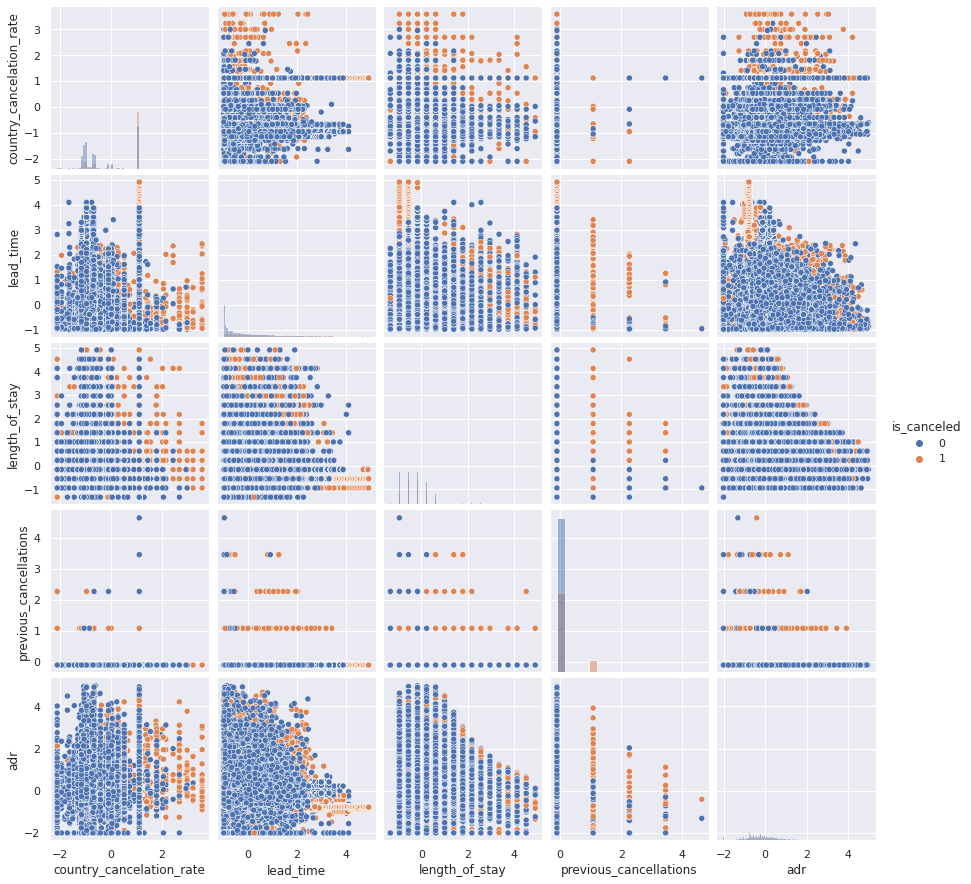

In [57]:
# looking at some continous variables colored by is_canceled. 
# run normed_full_nol for a look without outliers - higher prob of cancelation from long lead times, higher adr
sns.pairplot(normed_full_nol[['is_canceled','country_cancelation_rate','lead_time', 'length_of_stay', 'previous_cancellations','adr']], 
             diag_kind = 'hist', hue= 'is_canceled' )


`previous_cancelations` might be another attribute we convert to binary - yes previously canceled, or no. 

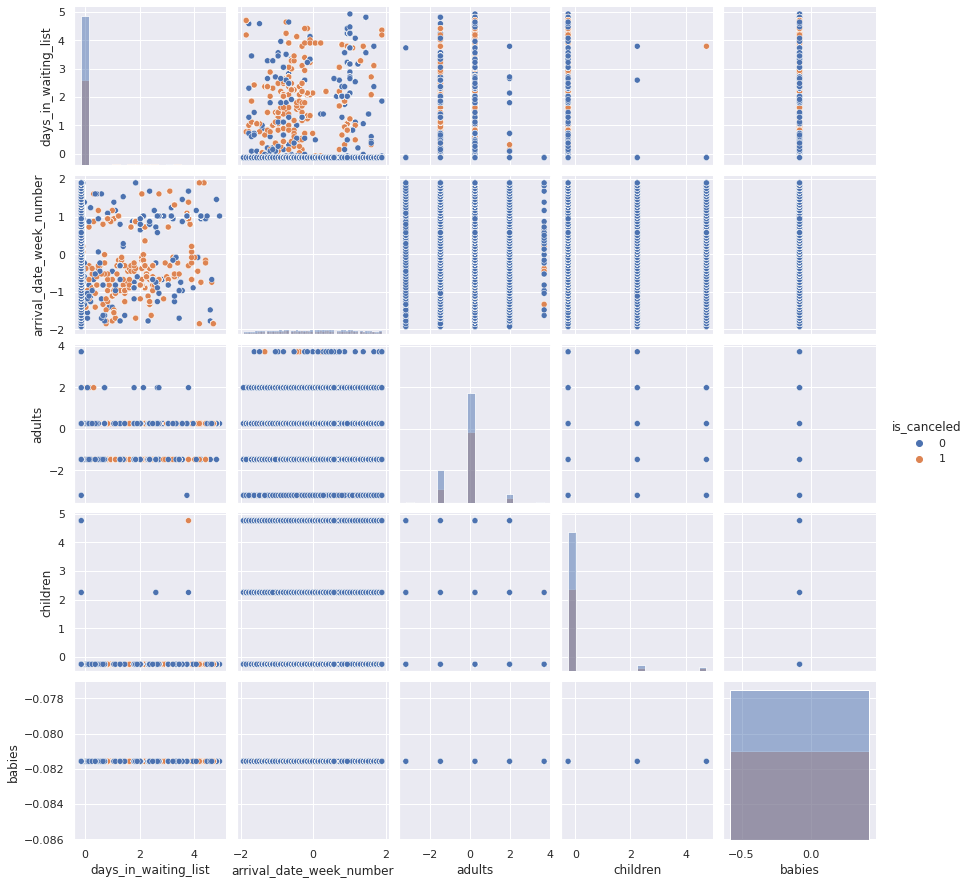

In [58]:
# just a second pair plot to read they get cumbersome quickly
sns.pairplot(normed_full_nol[['is_canceled','days_in_waiting_list', 'arrival_date_week_number', 'adults', 'children', 'babies']], 
             diag_kind = 'hist', hue= 'is_canceled' )

In [59]:
#Function for min_max_value details:
def min_max_values (col):
  top = hotel[col].idxmax()
  top_obs = pd.DataFrame(hotel.loc[top])

  bottom = hotel[col].idxmin()
  bottom_obs = pd.DataFrame(hotel.loc[bottom])

  min_max_obs = pd.concat([top_obs, bottom_obs], axis=1)

  return min_max_obs

In [60]:
min_max_values('adr')

,48515,0
hotel,City Hotel,Resort Hotel
is_canceled,1,0
lead_time,35,342
arrival_date_week_number,13,27
stays_in_weekend_nights,0,0
stays_in_week_nights,1,0
adults,2,2
children,0,0
babies,0,0
meal,BB,BB


# Exceptional Work - Lab 1

In [61]:
# preprocessing for pca analysis, dropping the 4 nan rows all from children
# adapted from https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html
# how many rows original dataframe had
print(len(hotelCont_mean_normed))

# determine where nan's are
is_NaN = hotelCont_mean_normed.isnull()
row_has_NaN = is_NaN.any(axis=1)
rows_with_NaN = hotelCont_mean_normed[row_has_NaN]
print(rows_with_NaN)

# remove nan rows
hotelCont_mean_normed.drop(axis = 0, index = rows_with_NaN.index, inplace = True)

# checking that the 4 rows are gone
print(len(hotelCont_mean_normed))


119390
Empty DataFrame
Columns: [is_canceled, lead_time, arrival_date_week_number, stays_in_weekend_nights, stays_in_week_nights, length_of_stay, previous_cancellations, previous_bookings_not_canceled, booking_changes, days_in_waiting_list, adr, required_car_parking_spaces, total_of_special_requests, adults, children, babies, total_revenue, country_cancelation_rate]
Index: []
119390


In [62]:
# https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html

from sklearn.decomposition import PCA
pca = PCA(n_components=len(hotel_nol.columns))
pca.fit(hotel_nol)

PCA(n_components=18)

In [63]:
import plotly.express as px

In [64]:
# visuallizing some PCA, not super useful since we dont have issues with correlation, unless we can discern something from the PCs
# adapted from https://plotly.com/python/pca-visualization/

components = pca.fit_transform(hotel_nol)
total_var = pca.explained_variance_ratio_.sum() * 100
n_components = 4

fig = px.scatter_matrix(
    components,
    color=hotel_nol.is_canceled,
    dimensions=range(n_components),
    title=f'Total Explained Variance: {total_var:.2f}%',
)
fig.show()

In [65]:
# the components are all very small 
pca.components_

array([[-8.05821147e-03,  1.11694456e-01,  5.71960157e-02,
         4.01094726e-01,  4.35100916e-01,  4.81276615e-01,
        -1.90885104e-02, -2.36756442e-02,  4.06360149e-02,
        -1.76364045e-02,  2.32571117e-01,  9.44681853e-04,
         1.54565628e-01,  1.63748461e-01,  1.31301044e-01,
        -0.00000000e+00,  4.85193216e-01, -2.05029504e-01],
       [-1.38358198e-01, -4.32358890e-01, -5.47525617e-02,
        -1.74488541e-01, -2.09935994e-01, -2.24781324e-01,
        -5.60325563e-02,  5.44623631e-03,  4.80069895e-02,
        -4.18839350e-02,  4.28698792e-01,  2.79096702e-01,
         4.09060029e-01,  1.27722769e-01,  3.58372785e-01,
        -0.00000000e+00,  5.42739236e-02, -2.86274604e-01],
       [ 1.80104562e-01,  3.90346623e-01,  4.88691461e-01,
        -1.80893715e-01, -1.11235461e-01, -1.53634939e-01,
         5.24048676e-02, -2.37175307e-02, -6.69873946e-02,
         3.49386420e-02,  3.97753707e-01, -1.02493634e-01,
        -1.34136781e-01,  1.75751453e-01,  3.60178390e

# Mini Lab

## Classifier DataFrame Preprocessing
- Company to Boolean
- Agent to Boolean
- Added attribute right_room (0 if room was changed, 1 if it wasn't)
- Added one hot encoding for other categories
- KNN works better without country, everything else works better with country
- market segment undefined only has 2 observations
- So far it seems that the non-parametric models do best
- Best accuracy is from Tree Classifier at around 87%
  

  Apologies for the dataset names, I'm open to better ones


In [36]:
# Libraries
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV, Ridge, Lasso
from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn import metrics
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import RFE
from dataframe_column_identifier import DataFrameColumnIdentifier
from sklearn.metrics import accuracy_score 
from sklearn.utils import shuffle
from sklearn import svm

### Additional feature engineering

In [37]:
# Changing Company to be a boolean variable. Running into issues when we split train/test that some of these are too rare to be populated

company_adjust = pd.DataFrame(normed_full_nol['company'])
company_adjust.replace(to_replace='Unknown', value = 0, inplace=True)
company_adjust = company_adjust.astype('float64')

# https://stackoverflow.com/questions/45790889/replace-non-zero-values-in-a-pandas-dataframe-with-1
company_adjust = company_adjust.astype(bool).astype(int)
company_adjust.head(20)

,company
0,0
2,0
3,0
4,0
5,0
6,0
7,0
8,0
9,0
10,0


In [38]:
# Changing Agent to be a boolean variable. Running into issues when we split train/test that some of these are too rare to be populated
agent_adjust = pd.DataFrame(normed_full_nol['agent'])
agent_adjust.replace(to_replace='Unknown', value = 0, inplace=True)
agent_adjust = agent_adjust.astype(bool).astype(int)
agent_adjust.head(10)

,agent
0,0
2,0
3,1
4,1
5,1
6,0
7,1
8,1
9,1
10,1


In [39]:
trial_df = normed_full_nol
trial_df['assigned_room_type'].dtype,trial_df['reserved_room_type'].dtype

(CategoricalDtype(categories=['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'K', 'L', 'P'], ordered=False),
 CategoricalDtype(categories=['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'L', 'P'], ordered=False))

In [40]:
trial_df

,is_canceled,lead_time,arrival_date_week_number,stays_in_weekend_nights,stays_in_week_nights,length_of_stay,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,...,market_segment,distribution_channel,is_repeated_guest,reserved_room_type,assigned_room_type,stays_in_week_nights_cat,stays_in_weekend_nights_cat,reservation_status_date,arrival_date,departure_date
0,0,2.227042,-0.012140,-0.928887,-1.310234,-1.340365,-0.103179,-0.091554,4.260083,-0.131923,...,Direct,Direct,0,C,C,0,0,2015-07-01,2015-07-01,2015-07-01
2,0,-0.907810,-0.012140,-0.928887,-0.786204,-0.949348,-0.103179,-0.091554,-0.338988,-0.131923,...,Direct,Direct,0,A,C,1,0,2015-07-02,2015-07-01,2015-07-02
3,0,-0.851664,-0.012140,-0.928887,-0.786204,-0.949348,-0.103179,-0.091554,-0.338988,-0.131923,...,Corporate,Corporate,0,A,A,1,0,2015-07-02,2015-07-01,2015-07-02
4,0,-0.842306,-0.012140,-0.928887,-0.262173,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,...,Online TA,TA/TO,0,A,A,1,0,2015-07-03,2015-07-01,2015-07-03
5,0,-0.842306,-0.012140,-0.928887,-0.262173,-0.558332,-0.103179,-0.091554,-0.338988,-0.131923,...,Online TA,TA/TO,0,A,A,1,0,2015-07-03,2015-07-01,2015-07-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119385,0,-0.758086,0.575873,1.073890,1.309918,1.396749,-0.103179,-0.091554,-0.338988,-0.131923,...,Offline TA/TO,TA/TO,0,A,A,1,1,2017-09-06,2017-08-30,2017-09-06
119386,0,-0.018822,0.575873,1.073890,1.309918,1.396749,-0.103179,-0.091554,-0.338988,-0.131923,...,Online TA,TA/TO,0,E,E,1,1,2017-09-07,2017-08-31,2017-09-07
119387,0,-0.655151,0.575873,1.073890,1.309918,1.396749,-0.103179,-0.091554,-0.338988,-0.131923,...,Online TA,TA/TO,0,D,D,1,1,2017-09-07,2017-08-31,2017-09-07
119388,0,0.046682,0.575873,1.073890,1.309918,1.396749,-0.103179,-0.091554,-0.338988,-0.131923,...,Online TA,TA/TO,0,A,A,1,1,2017-09-07,2017-08-31,2017-09-07


In [41]:
# Checking whether rooms matched wont let me convert since there are different number of categories....
#https://stackoverflow.com/questions/44067524/creating-a-new-column-depending-on-the-equality-of-two-other-columns and MATT
trial_df['right_room'] = np.where((trial_df['reserved_room_type'].astype(str)==trial_df['assigned_room_type'].astype(str)), 1, 0)
trial_df.right_room

0         1
2         0
3         1
4         1
5         1
         ..
119385    1
119386    1
119387    1
119388    1
119389    1
Name: right_room, Length: 115232, dtype: int64

In [42]:
# checking types and columns
dummy_trial = normed_full_nol.drop(['company','agent','is_canceled', 'reservation_status'], axis = 1)
dummy_trial['company'] = company_adjust
dummy_trial['agent'] = agent_adjust
dummy_trial['right_room'] = trial_df['right_room']
dummy_trial = pd.get_dummies(dummy_trial)
dummy_trial.dtypes, dummy_trial.shape

(lead_time                        float64
 arrival_date_week_number         float64
 stays_in_weekend_nights          float64
 stays_in_week_nights             float64
 length_of_stay                   float64
                                   ...   
 assigned_room_type_P               uint8
 stays_in_week_nights_cat_0         uint8
 stays_in_week_nights_cat_1         uint8
 stays_in_weekend_nights_cat_0      uint8
 stays_in_weekend_nights_cat_1      uint8
 Length: 256, dtype: object,
 (115232, 256))

In [43]:
# creating datasets to split
xlog = dummy_trial.select_dtypes(exclude=['datetime64'])
ylog = normed_full_nol['is_canceled']

# sanity checks
xlog.shape, ylog.shape

((115232, 253), (115232,))

### Building the training and test sets

In [44]:
# building test and train set
x_train, x_test, y_train, y_test = train_test_split(xlog,ylog, test_size = 0.25, random_state = 15)

In [45]:
# sanity checks
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((86424, 253), (28808, 253), (86424,), (28808,))

## SVM Model

In [46]:
y_train

32101     0
119353    0
49974     1
40249     1
113895    0
         ..
51586     1
71208     1
8422      0
55642     1
7957      1
Name: is_canceled, Length: 86424, dtype: category
Categories (2, int64): [0, 1]

In [69]:
# downsampling the data to a more manageable size for SVM

# keeping the existing balance of the response in our sample
x_train_canceled = x_train.loc[y_train == 1]
x_train_not_canceled = x_train.loc[y_train == 0]     

y_train_canceled = y_train.loc[y_train == 1]
y_train_not_canceled = y_train.loc[y_train == 0]  
                                       
canceled_percent = pd.to_numeric(y_train).sum()/len(x_train.index)
not_canceled_percent = 1 - canceled_percent

canceled_count = int(round(50000*canceled_percent,0))
not_canceled_count = int(50000 - canceled_count)

downsampled_canceled_x_train_df = x_train_canceled.sample(n=canceled_count, random_state=42)
downsampled_not_canceled_x_train_df = x_train_not_canceled.sample(n=not_canceled_count, random_state=42)

downsampled_canceled_y_train_df = y_train_canceled.sample(n=canceled_count, random_state=42)
downsampled_not_canceled_y_train_df = y_train_not_canceled.sample(n=not_canceled_count, random_state=42)

downsampled_x_train_df = downsampled_canceled_x_train_df.append(downsampled_not_canceled_x_train_df)
downsampled_y_train_df = downsampled_canceled_y_train_df.append(downsampled_not_canceled_y_train_df)

# breaking the downsampled df into training and test set
# building test and train set
x_train_ds, x_test_ds, y_train_ds, y_test_ds = train_test_split(downsampled_x_train_df,downsampled_y_train_df, test_size = 0.25, random_state = 15)

### Checking the linear separability for our data in SVM

In [ ]:
clf = svm.SVC(kernel='rbf', class_weight={1: 3}, C=100, random_state=42, cache_size=1000)
clf.fit(x_train, y_train)

In [71]:
# SVM metrics
ypred = clf.predict(x_test)
print("Accuracy:",round(metrics.accuracy_score(y_test, ypred),4))
print("Precision:",round(metrics.precision_score(y_test, ypred),4))
print("Recall:",round(metrics.recall_score(y_test, ypred),4))

Accuracy: 0.8031
Precision: 0.6754
Recall: 0.9156


In [ ]:
clf = svm.SVC(kernel='rbf', class_weight={1: 3}, C=300, random_state=42, cache_size=1000)
clf.fit(x_train, y_train)

In [ ]:
# SVM metrics
ypred = clf.predict(x_test)
print("Accuracy:",round(metrics.accuracy_score(y_test, ypred),4))
print("Precision:",round(metrics.precision_score(y_test, ypred),4))
print("Recall:",round(metrics.recall_score(y_test, ypred),4))

In [ ]:
# SVM cross fold 10
Val_score = cross_val_score(clf, x_test, y_test,cv=10)
Val_score.mean()

In [ ]:
# adapted from 
# https://scikit-learn.org/stable/auto_examples/svm/plot_svm_kernels.html


# figure number
fignum = 1

# fit the model
for kernel in ('linear', 'poly', 'rbf'):
    clf = svm.SVC(kernel=kernel, gamma=2)
    clf.fit(downsampled_x_train_df, downsampled_y_train_df)

    # plot the line, the points, and the nearest vectors to the plane
    plt.figure(fignum, figsize=(4, 3))
    plt.clf()

    plt.scatter(clf.support_vectors_[:, 0], clf.support_vectors_[:, 1], s=80,
                facecolors='none', zorder=10, edgecolors='k')
    plt.scatter(downsampled_x_train_df.iloc[:,0], downsampled_y_train_df, c=downsampled_y_train_df, zorder=10, cmap=plt.cm.Paired,
                edgecolors='k')

    plt.axis('tight')
    x_min = -3
    x_max = 3
    y_min = -3
    y_max = 3

    XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
    XX
    
#     Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

#     # Put the result into a color plot
#     Z = Z.reshape(XX.shape)
#     plt.figure(fignum, figsize=(4, 3))
#     plt.pcolormesh(XX, YY, Z > 0, cmap=plt.cm.Paired)
#     plt.contour(XX, YY, Z, colors=['k', 'k', 'k'], linestyles=['--', '-', '--'],
#                 levels=[-.5, 0, .5])

#     plt.xlim(x_min, x_max)
#     plt.ylim(y_min, y_max)

#     plt.xticks(())
#     plt.yticks(())
#     fignum = fignum + 1
# plt.show()


### Gridsearch SVM Hyper Parameter Tuning

In [ ]:
#https://scikit-learn.org/stable/auto_examples/model_selection/plot_grid_search_digits.html
from sklearn.metrics import classification_report

# Set the parameters by cross-validation
tuned_parameters = [{'kernel': ['linear'], 'C': [1, 10, 100, 1000]},
                   {'kernel': ['poly'], 'C': [1, 10, 100, 1000]},
                   {'kernel': ['rbf'], 'C': [1, 10, 100, 1000]},]
scores = ['precision', 'recall']
for score in scores:
    print(f"# Tuning hyper-parameters for {score}")
    print()
    clf = GridSearchCV(
        SVC(), tuned_parameters, scoring=f'{score}_macro', n_jobs=-1, verbose = 1, return_train_score=True
    )
    clf.fit(x_train,y_train)
    print("Best parameters set found on development set:")
    print()
    print(clf.best_params_)
    print()
    print("Grid scores on development set:")
    print()
    means = clf.cv_results_['mean_test_score']
    stds = clf.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, clf.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for %r"
              % (mean, std * 2, params))
    print()
    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()
    y_true, y_pred = y_test, clf.predict(x_test)

Beause the hyper parameter optimally picked a linear kernal for SVM, and our large data set, we have decided to use Stochastic Gradient Descent to more efficiently optimize the cost function.

### SVM model

In [ ]:
# Stochastic gradient descent - SVM Linear
from sklearn.linear_model import SGDClassifier
clf = SGD(verbose = 1, n_jobs = -1, random_state=42)
clf.fit(x_train,y_train)

SVC(gamma='auto')

In [ ]:
# SVM metrics
ypred = clf_SVM.predict(xkbest_test)
print("Accuracy:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall:",round(metrics.recall_score(ylog_test, ypred),4))

Accuracy: 0.8205
Precision: 0.8399
Recall: 0.6369


## Logistic regression

In [ ]:
# https://stackoverflow.com/questions/38640109/logistic-regression-python-solvers-defintions

# Saga solver for larger datasets quicker, allows the combination of L1 and L2 penalties with elasticnet, allows n_jobs
# this allows us to cut the penalty portion of the search, also class weight balanced was used to auto set the weights.
clflr = LogisticRegression(solver='saga', max_iter = 500, class_weight = 'balanced', n_jobs = -1, random_state = 42

In [ ]:
#https://stackoverflow.com/questions/19018333/gridsearchcv-on-logisticregression-in-scikit-learn

#logistic regression gridsearch hyper parameters
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

grid_values = {'penalty': ['l1','l2'], 'C': [0.001,0.01,0.1,1,10,100,1000]}

grid = GridSearchCV(clflr, grid_values, cv=3, n_jobs=-1, scoring=['accuracy', 'precision', 'recall', 'f1'], verbose=1, 
                    return_train_score=True, refit='accuracy')

grid.fit(x_train,y_train)
gridpred = grid.predict(x_test)

# examine the best model
print("Accuracy:",round(metrics.accuracy_score(y_test, gridpred),4))
print("Precision:",round(metrics.precision_score(y_test, gridpred),4))
print("Recall:",round(metrics.recall_score(y_test, gridpred),4))
print(grid.best_score_)
print(grid.best_params_)

In [ ]:
# Results 
cv_results = pd.DataFrame(grid.cv_results_)
cv_results[['mean_test_accuracy', 'mean_test_precision', 'mean_test_recall', 'mean_test_f1']]

In [ ]:
print(cv_results[['mean_test_accuracy']].idxmax(),cv_results[['mean_test_precision']].idxmax(),
      cv_results[['mean_test_recall']].idxmax(),cv_results[['mean_test_f1']].idxmax())

In [ ]:
# Model intiation with tuned hyper parameters
clflr = LogisticRegression(solver='saga',penalty='l2',C=1, max_iter=500, class_weight='balanced', n_jobs=-1, random_state=42)
clflr.fit(x_train,y_train)

In [ ]:
#https://machinelearningmastery.com/calculate-feature-importance-with-python/

# Feature importance unsorted
importance = clflr.coef_[0]
for i,v in enumerate(importance):
    print('Feature: %0d, Score: %.5f' % (i,v))

# plot feature importance
plt.bar([x for x in range(len(importance))], importance)
plt.show()



In [ ]:
#https://towardsdatascience.com/explain-your-machine-learning-with-feature-importance-774cd72abe

# Feature Importance
col_sorted_by_importance=importance.argsort()
feat_imp=pd.DataFrame({
    'cols': x_train.columns[col_sorted_by_importance],
    'imps':importance[col_sorted_by_importance]
})


In [ ]:
import plotly.express as px
px.bar(feat_imp, x='cols', y='imps')

In [ ]:
#https://www.datacamp.com/community/tutorials/understanding-logistic-regression-python
y_pred_proba = clflr.predict_proba(x_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

#### Gridsearch Variable Selection
Using cross validated grid search to narrow down the number of features

In [ ]:
# Gridsearch variable Selection
# https://gijopeter.medium.com/cross-validation-for-ml-feature-selection-ffdb71e5a68f
# step-1: create a cross-validation scheme
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
#  Using 3 fold here because our machines slug through fitting 3 folds for each of 253 candidates, totalling 759 fits
folds = KFold(n_splits = 3, shuffle = True, random_state = 42)
# step-2: specify range of hyperparameters to tune, consider all available #features
hyper_params = [{'n_features_to_select': list(range(1, len(x_train.columns)+1))}]
# step-3: perform grid search
# 3.1 specify model
lr = LogisticRegression(solver="saga", penalty="l2", C=1, n_jobs = -1,random_state=42)
lr.fit(x_train, y_train)
rfe = RFE(lr)
# 3.2 call GridSearchCV(), return_train_score=True ensure that train score #along with test score will be returned
model_cv = GridSearchCV(estimator = rfe, param_grid = hyper_params, scoring= 'accuracy',
                        cv = folds, n_jobs=-1, verbose = 1, return_train_score=True)
# fit the model
model_cv.fit(x_test, y_test)
# The returned cross validation(model_cv)object contains an attribute model_cv.cv_results_ which is quite useful for analysing the cross validation results
# cv results
cv_results = pd.DataFrame(model_cv.cv_results_)
cv_results['mean_test_score']

In [ ]:
plt.figure(figsize=(16,6))
plt.plot(cv_results['param_n_features_to_select'], cv_results['mean_test_score'])
plt.plot(cv_results['param_n_features_to_select'], cv_results['mean_train_score'])
plt.xlabel('number of features')
# plt.xlim(0,250)
plt.ylabel('accuracy')
#plt.ylim(0.9,1.001)
plt.title('Optimal Number of Features')
plt.legend(['test score', 'train score'], loc='upper right')

In [ ]:
df = pd.DataFrame(cv_results.groupby(['param_n_features_to_select'])['mean_test_score'].max())
print(df[df.mean_test_score == df.mean_test_score.max()])

## Model Cross Validations

### Logistic regression w/out feature selection

In [ ]:
# Log Reg no variable selection
Val_score = cross_val_score(clfLR, xlog_test, ylog_test,cv=10)
Val_score.mean()

0.6553231892516198

### Decision tree

In [ ]:
# Decision Tree
Val_score = cross_val_score(clfDT, xlog_test, ylog_test,cv=10)
Val_score.mean()

0.6754523694352579

### Decision tree with feature selection

In [ ]:
# Decision Tree Selection Into Log Reg
Val_score = cross_val_score(clfDTLR, Xdt_Best_test, ylog_test,cv=10)
Val_score.mean()

0.8174466813220718

### Logistic regression with k-best top 20

In [ ]:
# Log Reg with 20 Kbest
Val_score = cross_val_score(clfKbest, xkbest_test, ylog_test,cv=10)
Val_score.mean()

0.8013400295036446

In [ ]:
# Log Reg using the decision tree and kbest for selection
Val_score = cross_val_score(clfDTLRBest, Xdt_Best_test, ylog_test,cv=10)
Val_score.mean()

0.8174119711519918

### KNN

In [ ]:
# KNN
Val_score = cross_val_score(neigh, xlog_test, ylog_test,cv=10)
Val_score.mean()

0.8168213679663697

### SVM with k-best top 20

In [ ]:
# SVM with 20 Kbest
Val_score = cross_val_score(clf_SVM, xkbest_test, ylog_test,cv=10)
Val_score.mean()

0.8173422736125573

In [ ]:
# SVM with 20 Kbest and linear
Val_score = cross_val_score(clf_SVM_lin, xkbest_test, ylog_test,cv=10)
Val_score.mean()

0.8003679760114158

In [ ]:
# SVM with 20 Kbest and poly
Val_score = cross_val_score(clf_SVM_poly, xkbest_test, ylog_test,cv=10)
Val_score.mean()

0.8149471151991978

# Extra stuff down here

In [ ]:
# Neat tool to help get column names from Kbest and tree selection
# https://pypi.org/project/dataframe-column-identifier/
!pip install dataframe-column-identifier==0.0.5

# Adam's Logistic Regression Box
- Log Reg (LR)
- Decision Tree (DT)
- DT LR
- Kbest LR
- KNN
- SVM

# Future Improvements
- Need a loop or some other method to change the random seed a few times and recalculate the scores
- Check different sampling methods

In [ ]:
# Training Model 100/500 iterations and solver='lbfgs' failed to converge
# liblinear converged - seems to be fastest - also no noticeable changes in accuracy or other metrics when solver method is anything else
# Logistic Regression supports only solvers in ['liblinear', 'newton-cg', 'lbfgs', 'sag', 'saga']
clfLR = LogisticRegression(max_iter = 500, solver='liblinear')
clfLR.fit(xlog_train,ylog_train)

# getting predictions and checking them out - earlier sanity checks
ypred = clfLR.predict(xlog_test)
d = {"Observed":ylog_test, "Predicted":ypred}
check = pd.DataFrame(d)
#check

print("Accuracy Log Reg Only:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision Log Reg Only:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall Log Reg Only:",round(metrics.recall_score(ylog_test, ypred),4))

Accuracy Log Reg Only: 0.82
Precision Log Reg Only: 0.8106
Recall Log Reg Only: 0.6709


Future Visual commented out for cleanliness while testing

In [ ]:
# https://www.datacamp.com/community/tutorials/understanding-logistic-regression-python
# Run this code for the visual representation of the above

# from sklearn import metrics
# cnf_matrix = metrics.confusion_matrix(ylog_test, ypred)
# # cnf_matrix

# class_names=[0,1] # name  of classes
# fig, ax = plt.subplots()
# tick_marks = np.arange(len(class_names))
# plt.xticks(tick_marks, class_names)
# plt.yticks(tick_marks, class_names)
# # create heatmap
# sns.heatmap(pd.DataFrame(cnf_matrix), annot=True, cmap="YlGnBu" ,fmt='g')
# ax.xaxis.set_label_position("top")
# plt.tight_layout()
# plt.title('Confusion matrix', y=1.1)
# plt.ylabel('Actual label')
# plt.xlabel('Predicted label')
# print("Accuracy:",round(metrics.accuracy_score(ylog_test, ypred),4))
# print("Precision:",round(metrics.precision_score(ylog_test, ypred),4))
# print("Recall:",round(metrics.recall_score(ylog_test, ypred),4))

### Basic decision tree model

In [ ]:
# Decision Tree Normal
# https://scikit-learn.org/stable/modules/feature_selection.html
# https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
# Variable selection using a tree
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.feature_selection import SelectFromModel

clfDT = ExtraTreesClassifier(n_estimators=25, criterion='entropy', max_features='sqrt')
clfDT = clfDT.fit(xlog_train, ylog_train)  
model = SelectFromModel(clfDT, prefit=True)
X_DT_Train = model.transform(xlog_train)
print(f'Train Shape is {X_DT_Train.shape}')    

# Decision Tree Normal
# transforming the test set
X_DT_Test = model.transform(xlog_test)
print(f'Test Shape is {X_DT_Test.shape}') 
print("-"*30)
ypred = clfDT.predict(xlog_test)

print("Accuracy DT Only:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision DT Only:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall DT Only:",round(metrics.recall_score(ylog_test, ypred),4))
print("-"*30)

# Decision Tree Variable Selection into Logistic Regression
# generating model and checking metric on the tree selected columns - 
clfDTLR = LogisticRegression(max_iter = 500, solver='liblinear')
clfDTLR.fit(X_DT_Train,ylog_train)

ypred = clfDTLR.predict(X_DT_Test)
d = {"Observed":ylog_test, "Predicted":ypred}
check = pd.DataFrame(d)

print("Accuracy DTLR:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision DTLR:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall DTLR:",round(metrics.recall_score(ylog_test, ypred),4))
print("-"*30)

Train Shape is (86424, 40)
Test Shape is (28808, 40)
------------------------------
Accuracy DT Only: 0.8692
Precision DT Only: 0.8453
Recall DT Only: 0.7918
------------------------------
Accuracy DTLR: 0.8182
Precision DTLR: 0.8111
Recall DTLR: 0.6638
------------------------------


### Decision tree using top 25 features

In [ ]:
# Decision Tree Grabbing top 25
# using feature importance on tree to see what the decent predictors are
feature_list = clfDT.feature_importances_

# https://medium.com/@yurybelousov/the-beauty-of-python-or-how-to-get-indices-of-n-maximum-values-in-the-array-d362385794ef
# grabs index of N largest values 
import heapq
best_features = heapq.nlargest(25, range(len(feature_list)), feature_list.take)

# Scores of the best features, need to run this down more - what scores?
clfDT.feature_importances_[best_features]

# if you want to see what the best features are
# https://datascience.stackexchange.com/questions/31406/tree-decisiontree-feature-importances-numbers-correspond-to-how-features
# dt_best = dict(zip(xlog_train.columns, clfDT.feature_importances_[best_features]))
# dt_best.keys()

# Set new columns in train/test
Xdt_Best_train = xlog_train[xlog_train.columns[best_features]]
Xdt_Best_test = xlog_test[xlog_train.columns[best_features]]
print(f'Train Shape: {Xdt_Best_train.shape}, Test Shape: {Xdt_Best_test.shape}')
print("-"*30)

clfDTLRBest = LogisticRegression(max_iter = 500, solver='lbfgs')
clfDTLRBest.fit(Xdt_Best_train,ylog_train)

ypred = clfDTLRBest.predict(Xdt_Best_test)
d = {"Observed":ylog_test, "Predicted":ypred}
check = pd.DataFrame(d)

print("Accuracy DT Best LR:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision DT Best LR:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall DT Best LR:",round(metrics.recall_score(ylog_test, ypred),4))
print("-"*30)

Train Shape: (86424, 25), Test Shape: (28808, 25)
------------------------------
Accuracy DT Best LR: 0.8171
Precision DT Best LR: 0.8122
Recall DT Best LR: 0.6583
------------------------------


### K-best model

In [ ]:
# Start of K Best
# https://www.datacamp.com/community/news/feature-selection-using-selectkbest-0dv0fo0qqe48
from sklearn.feature_selection import SelectKBest, SelectFwe, f_classif
dfci = DataFrameColumnIdentifier()
kbest = SelectKBest(score_func=f_classif, k=20)
kbest.fit_transform(xlog_train, ylog_train)
kbest_get_support_output = kbest.get_support()

#print(kbest_get_support_output)

/home/bensonnd/anaconda3/envs/ml1-7331/lib/python3.7/site-packages/sklearn/feature_selection/_univariate_selection.py:115: UserWarning:

Features [ 42  44  50  51 104 145 184 191 210 219] are constant.

/home/bensonnd/anaconda3/envs/ml1-7331/lib/python3.7/site-packages/sklearn/feature_selection/_univariate_selection.py:116: RuntimeWarning:

invalid value encountered in true_divide



In [ ]:
# Kbest will tell you what columns are singular
xlog_train.columns[40]

'country_ARG'

In [ ]:
# Kbest columns selected
print(dfci.select_columns_KBest(xlog_train, kbest_get_support_output, verbose=1))

1 - Feature selected: lead_time
2 - Feature selected: previous_cancellations
3 - Feature selected: booking_changes
4 - Feature selected: required_car_parking_spaces
5 - Feature selected: total_of_special_requests
6 - Feature selected: country_cancelation_rate
7 - Feature selected: right_room
8 - Feature selected: hotel_City Hotel
9 - Feature selected: hotel_Resort Hotel
10 - Feature selected: deposit_type_No Deposit
11 - Feature selected: deposit_type_Non Refund
12 - Feature selected: customer_type_Transient
13 - Feature selected: customer_type_Transient-Party
14 - Feature selected: country_PRT
15 - Feature selected: market_segment_Direct
16 - Feature selected: market_segment_Groups
17 - Feature selected: distribution_channel_Direct
18 - Feature selected: distribution_channel_TA/TO
19 - Feature selected: assigned_room_type_A
20 - Feature selected: assigned_room_type_D
['lead_time', 'previous_cancellations', 'booking_changes', 'required_car_parking_spaces', 'total_of_special_requests', 

In [ ]:
# Kbest shaping dataframes
xkbest_train = dfci.transform(xlog_train)
xkbest_test = dfci.transform(xlog_test)

xkbest_train.shape, xkbest_test.shape

((86424, 20), (28808, 20))

### Logistic regression model with k-best top 20

In [ ]:
# Kbest Log Reg
# Needs own data set init using Kbest
# Logistic Regression supports only solvers in ['liblinear', 'newton-cg', 'lbfgs', 'sag', 'saga']
clfKbest = LogisticRegression(max_iter = 500, solver='liblinear')
clfKbest.fit(xkbest_train,ylog_train)

ypred = clfKbest.predict(xkbest_test)

print("Accuracy:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall:",round(metrics.recall_score(ylog_test, ypred),4))

Accuracy: 0.8013
Precision: 0.8028
Recall: 0.6144


### KNN model

In [ ]:
# KNN Model. added n_jobs to use multicores for classification
from sklearn.neighbors import KNeighborsClassifier, RadiusNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3, n_jobs=-1)
neigh.fit(xlog_train, ylog_train)

ypred = neigh.predict(xlog_test)

print("Accuracy:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall:",round(metrics.recall_score(ylog_test, ypred),4))

Accuracy: 0.8354
Precision: 0.7787
Recall: 0.7761


# GridsearchCV on logreg

In [ ]:
#https://stackoverflow.com/questions/19018333/gridsearchcv-on-logisticregression-in-scikit-learn
grid_values = {'penalty': ['l1','l2'], 'C': [0.001,0.01,0.1,1,10,100,1000]}
grid = GridSearchCV(clfKbest, grid_values, cv=15, n_jobs= -1, scoring= 'accuracy', verbose = 1, return_train_score=True)
grid.fit(xkbest_train,ylog_train)

gridpred = grid.predict(xkbest_test)

In [ ]:
# examine the best model and get C and penalty values
print("Accuracy:",round(metrics.accuracy_score(ylog_test, gridpred),4))
print("Precision:",round(metrics.precision_score(ylog_test, gridpred),4))
print("Recall:",round(metrics.recall_score(ylog_test, gridpred),4))
print(grid.best_score_)
print(grid.best_params_)

In [ ]:
#rerun with the added parameters
clfKbest = LogisticRegression(max_iter = 500, solver='liblinear', penalty = 'l2', C = .01)
clfKbest.fit(xkbest_train,ylog_train)

ypred = clfKbest.predict(xkbest_test)

print("Accuracy:",round(metrics.accuracy_score(ylog_test, ypred),4))
print("Precision:",round(metrics.precision_score(ylog_test, ypred),4))
print("Recall:",round(metrics.recall_score(ylog_test, ypred),4))

In [ ]:
#feature importance scores
#https://machinelearningmastery.com/calculate-feature-importance-with-python/
from matplotlib import pyplot
importance = clfKbest.coef_[0]
for i,v in enumerate(importance):
	print('Feature: %0d, Score: %.5f' % (i,v))
# plot feature importance
pyplot.bar([x for x in range(len(importance))], importance)
pyplot.show()

In [ ]:
#lets clean it up and call out the actual features
#https://towardsdatascience.com/explain-your-machine-learning-with-feature-importance-774cd72abe
col_sorted_by_importance=importance.argsort()
feat_imp=pd.DataFrame({
    'cols': xlog_train.columns[col_sorted_by_importance],
    'imps':importance[col_sorted_by_importance]
})

import plotly.express as px
px.bar(feat_imp, x='cols', y='imps')

In [ ]:
#ROC curve to show tradeoff between sens and spec
#https://www.datacamp.com/community/tutorials/understanding-logistic-regression-python
y_pred_proba = clfKbest.predict_proba(xkbest_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(ylog_test,  y_pred_proba)
auc = metrics.roc_auc_score(ylog_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

# Adams Linear Regression Box

In [ ]:
# importing neccessary libraries
from sklearn.linear_model import LinearRegression
from sklearn import linear_model as lm
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
# new data set to try out the one hot encoding cant use objects as regressors
dummy_trial = normed_full_nol

In [ ]:
# creation of the 1 hot encoding data set, blows up to 940 columns - man if we did one hot encoding to get our column count up our data set choice wouldve been massively inflated!
dummy_trial = pd.get_dummies(dummy_trial)
dummy_trial.shape

In [ ]:
# same as above, wtf
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
rmse

In [ ]:
# Regression did not like datetime64 dtypes would need to convert to some numerical value
dummy_trial.select_dtypes(include=['datetime64']).columns

In [ ]:
# preprocessing for regression, dropping datetimes and the perfect predictors plus sanity checks
x = dummy_trial.select_dtypes(exclude=['datetime64'])
x = x.drop(['length_of_stay', 'stays_in_weekend_nights', 'stays_in_week_nights'], axis = 1)
y = dummy_trial['length_of_stay']
x.shape, y.shape

In [ ]:
# building test and train set
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.4, random_state = 42)

In [ ]:
# sanity checks
x_train.shape, y_train.shape, x_test.shape, y_test.shape

In [ ]:
# setting up regression, I think I can do this and the next block on one line
linear_model = LinearRegression()

In [ ]:
# fitting
linear_model.fit(x_train,y_train)

In [ ]:
# predictions
y_pred = linear_model.predict(x_test)
y_pred

In [ ]:
# not sure whats going on just know its bad - not sure how to view all the fit metrics yet
mae = mean_absolute_error(y_test, y_pred)
mae

In [ ]:
# using Lasso to fit
# https://scikit-learn.org/stable/modules/linear_model.html
reg = lm.Lasso(alpha=0.1)
reg.fit(x_train,y_train)
y_pred = reg.predict(x_test)


In [ ]:
# way better - this mean we predict - need to figure out what this means in terms of scale of the error.
# since we normed everything the measurement is essentially per standard deviation
# so our error of ~ 0.293 is a percentage of standard deviation that we are off - not sure what this translates to as far as days
mae = mean_absolute_error(y_test, y_pred)
mae, normed_full_nol.length_of_stay.std(),normed_full_nol.length_of_stay.mean()

In [ ]:
# also way better
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
rmse

In [ ]:
# R^2 of ~ 0.7278
reg.score(x_test,y_test)